# Advance Machine Learning

#### -Mitali Patle(22537720)

### Table of Content

1. Data Processing for Machine Learning
2. Feature Engineering
3. Feature Selection and Dimensionality Reduction
4. Model Building
5. Model Evaluation and Analysis 

### 1. Data Processing for Machine Learning

* Importing all the required librariies. 

In [7]:
!pip install --upgrade scikit-learn category_encoders -q --user

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.6/9.6 MB 22.7 MB/s eta 0:00:00


In [8]:
!pip install --upgrade scikit-learn==1.2.0 --user

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached scikit_learn-1.2.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (9.5 MB)
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.2.2
    Uninstalling scikit-learn-1.2.2:
      Successfully uninstalled scikit-learn-1.2.2


In [9]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%config InlineBackend.figure_format='retina'
sns.set(
    rc={ "figure.figsize": (10,8) },
    style="ticks", context="notebook", font_scale=1.2
)

In [10]:
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline,make_pipeline
from sklearn.feature_selection import SelectKBest,chi2,f_regression
from sklearn import linear_model
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.model_selection import GridSearchCV, ParameterGrid
from sklearn.metrics import mean_squared_error
from functools import partial
rmse = partial(mean_squared_error, squared=False)
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.preprocessing import PolynomialFeatures,FunctionTransformer
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.decomposition import PCA
from sklearn.feature_selection import RFE
from sklearn.ensemble import VotingRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, balanced_accuracy_score,accuracy_score
from sklearn.model_selection import GridSearchCV

* Loading Dataset

In [11]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [12]:
advert=pd.read_csv("/content/drive/MyDrive/adverts.csv")
#advert=pd.read_csv("adverts.csv")
advert.head(3)

,public_reference,mileage,reg_code,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type
0,202006039777689,0.0,NaN,Grey,Volvo,XC90,NEW,NaN,73970,SUV,False,Petrol Plug-in Hybrid
1,202007020778260,108230.0,61,Blue,Jaguar,XF,USED,2011.0,7000,Saloon,False,Diesel
2,202007020778474,7800.0,17,Grey,SKODA,Yeti,USED,2017.0,14000,SUV,False,Petrol


* Shape of the Data set 

In [13]:
advert.shape

(402005, 12)

In [14]:
advert.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 402005 entries, 0 to 402004
Data columns (total 12 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   public_reference       402005 non-null  int64  
 1   mileage                401878 non-null  float64
 2   reg_code               370148 non-null  object 
 3   standard_colour        396627 non-null  object 
 4   standard_make          402005 non-null  object 
 5   standard_model         402005 non-null  object 
 6   vehicle_condition      402005 non-null  object 
 7   year_of_registration   368694 non-null  float64
 8   price                  402005 non-null  int64  
 9   body_type              401168 non-null  object 
 10  crossover_car_and_van  402005 non-null  bool   
 11  fuel_type              401404 non-null  object 
dtypes: bool(1), float64(2), int64(2), object(7)
memory usage: 34.1+ MB


Provided data set have 12 different columns out of which 4 columns have numeric values and other 8 have objects as Datatype. 

Range of Numeric Data by using describe()

In [15]:
advert.describe()

,public_reference,mileage,year_of_registration,price
count,4.020050e+05,401878.000000,368694.000000,4.020050e+05
mean,2.020071e+14,37743.595656,2015.006206,1.734197e+04
std,1.691662e+10,34831.724018,7.962667,4.643746e+04
min,2.013072e+14,0.000000,999.000000,1.200000e+02
25%,2.020090e+14,10481.000000,2013.000000,7.495000e+03
50%,2.020093e+14,28629.500000,2016.000000,1.260000e+04
75%,2.020102e+14,56875.750000,2018.000000,2.000000e+04
max,2.020110e+14,999999.000000,2020.000000,9.999999e+06


Here Mileage, Year of registration and Price are the parameters which will be required for further analysis. Also, we can see that the range of different features -

Mileage-> 0 to 999999

Price-> 120 to 9999999

Year of Registartion-> 999 to 2020

* Data Visualization and Data Exploration

In [16]:
advert.columns

Index(['public_reference', 'mileage', 'reg_code', 'standard_colour',
       'standard_make', 'standard_model', 'vehicle_condition',
       'year_of_registration', 'price', 'body_type', 'crossover_car_and_van',
       'fuel_type'],
      dtype='object')

<Axes: ylabel='vehicle_condition'>

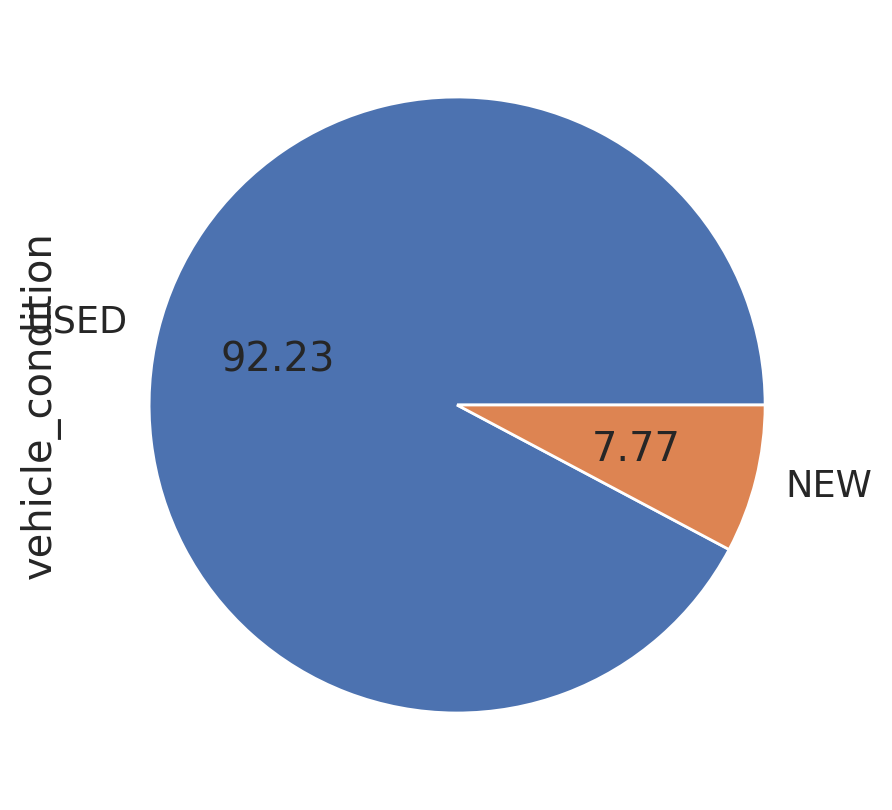

In [17]:
plt.figure(figsize=(5,5))
advert['vehicle_condition'].value_counts().plot(kind='pie',autopct='%.2f')

The above pie chart shows that there are only very less New vehicles and only used vehicles available.

<Axes: ylabel='year_of_registration'>

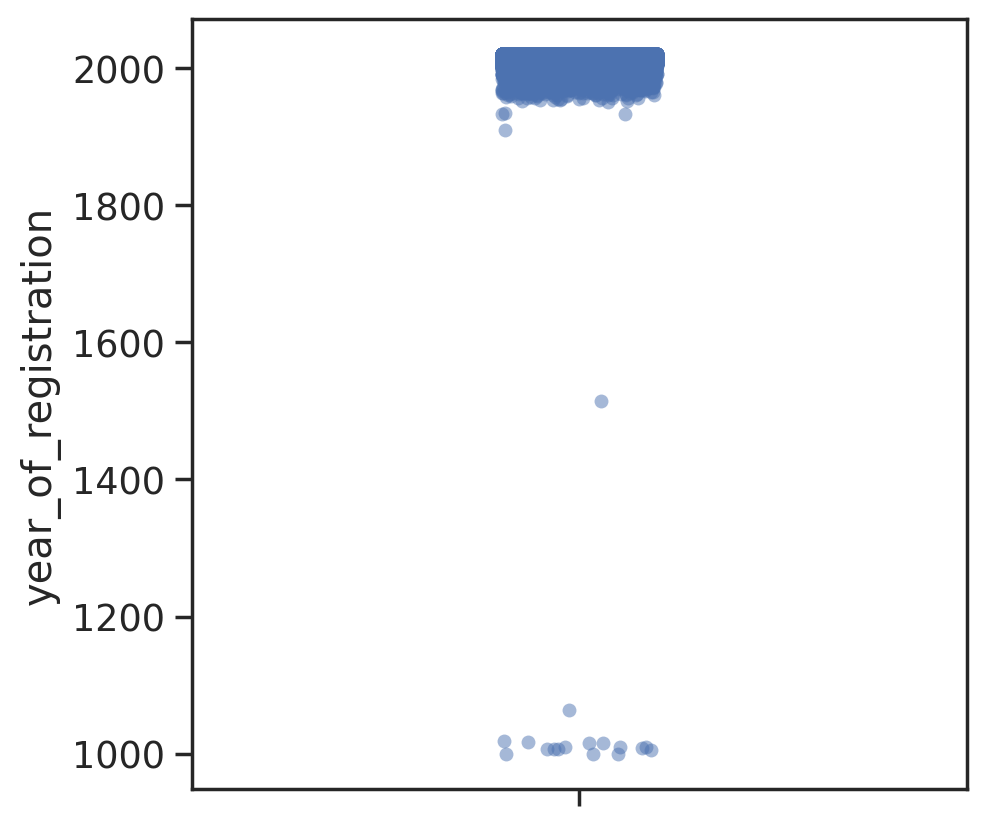

In [18]:
plt.figure(figsize=(5,5))
sns.stripplot(data=advert, y='year_of_registration',alpha=0.5)

The above plot shows the density or the number of vehicles in that particular year. It can be observed that majority of our vehicles have year of registration near to 2000's. 

<Axes: xlabel='mileage'>

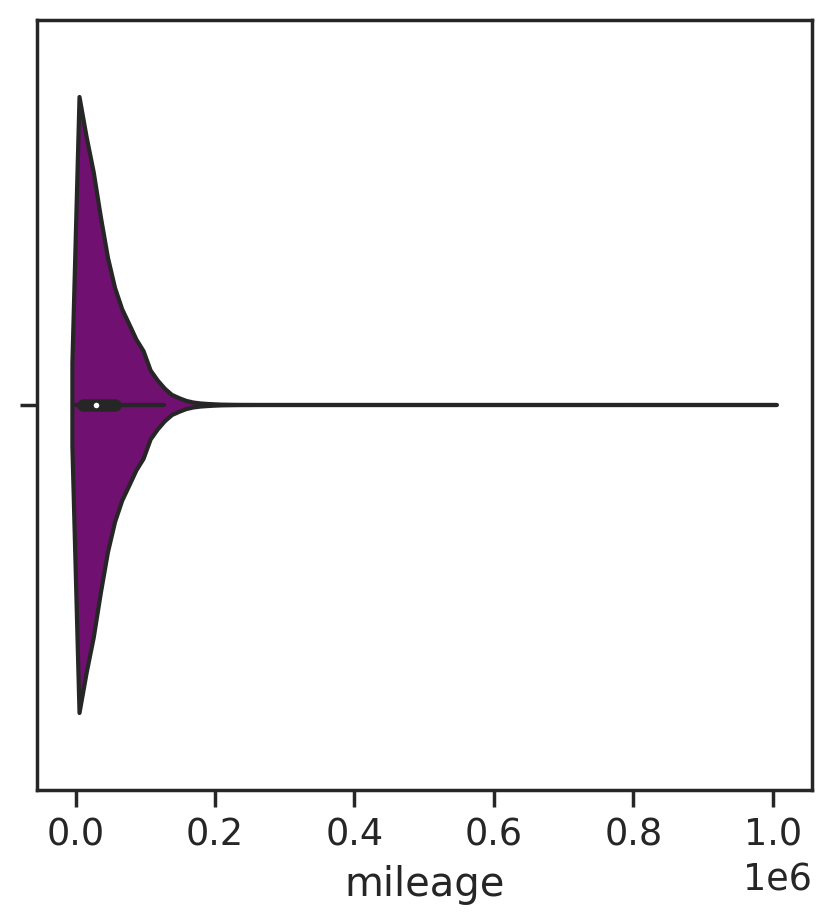

In [19]:
plt.figure(figsize=(5,5))
sns.violinplot(data=advert, x='mileage',color='purple')

The above violin plot shows the distribution of Mileage, it can be can seen that lots of data is outside the violin plot and far away from the box plot. Which means away from the standard deviation of the data.

<Axes: xlabel='price'>

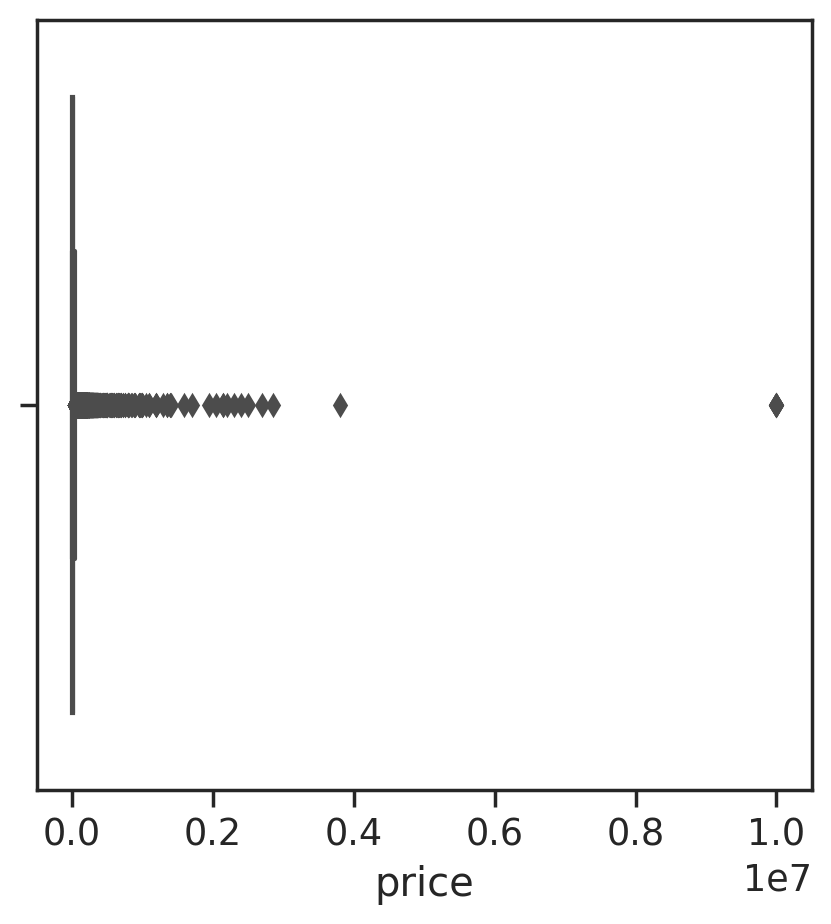

In [20]:
plt.figure(figsize=(5,5))
sns.boxplot(data=advert, x='price')

This boxplots shows the distribution of price. There are very vehicle which has higher price value and lots of Data outside the boxplot.

It can be seen from the above plots that all the quantitaive data is very widely spread along the range. However, this data is not spread evenly and there lots of outliers in the data. 

Dropping out the columns from the dataset which are not required

In [21]:
advert=advert.drop(columns=['public_reference', 'reg_code'])

In [22]:
advert.sample(5)

,mileage,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type
49273,102000.0,Black,BMW,3 Series,USED,2007.0,6995,Coupe,False,Petrol
51850,47371.0,White,Toyota,Auris,USED,2014.0,9200,Hatchback,False,Petrol Hybrid
34348,72000.0,White,Nissan,Note,USED,2014.0,4990,Hatchback,False,Diesel
345059,51000.0,Grey,Mercedes-Benz,GLE Class,USED,2017.0,24890,SUV,False,Diesel
331223,119000.0,Blue,Volkswagen,Golf,USED,2007.0,2190,Hatchback,False,Diesel


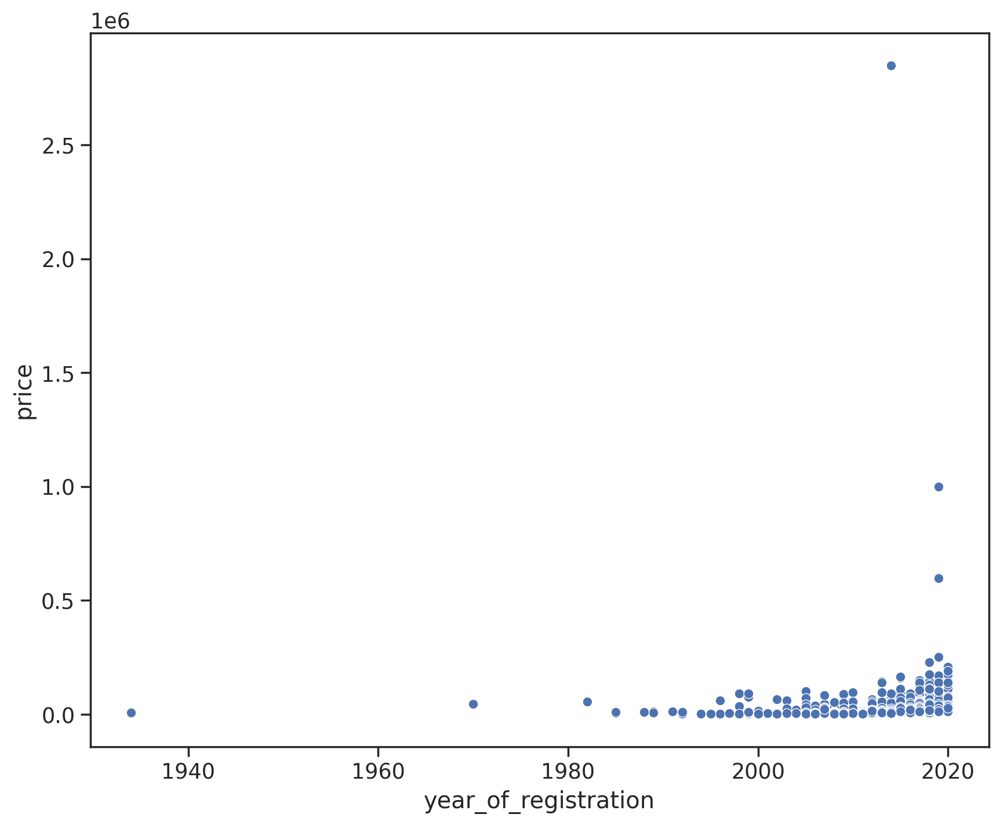

In [23]:
ds=advert.sample(5000)
plt.figure(figsize=(10,8))
sns.scatterplot(data=ds,x='year_of_registration',y='price')
plt.savefig("Year vs Price.png")

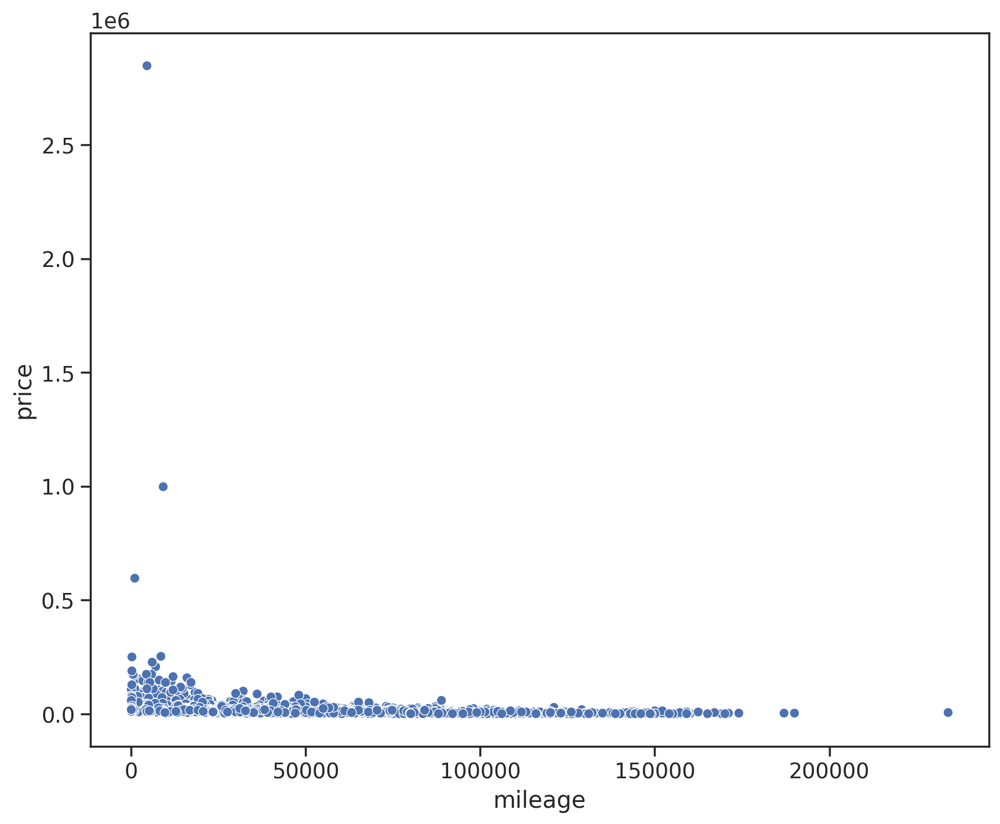

In [24]:
plt.figure(figsize=(10,8))
sns.scatterplot(data=ds,x='mileage',y='price')
plt.savefig("Mileage vs Price.png")

* Identifying Missing values

In [25]:
advert.isna().sum()

mileage                    127
standard_colour           5378
standard_make                0
standard_model               0
vehicle_condition            0
year_of_registration     33311
price                        0
body_type                  837
crossover_car_and_van        0
fuel_type                  601
dtype: int64

* Dealing with missing values

The missing values in the quantitave data can be filled with the mean value and fro the categoical data we can fill the missing value with the maximum occuring values.

In [26]:
advert['mileage']= advert['mileage'].fillna(advert['mileage'].mean())

In [27]:
advert['year_of_registration']=advert['year_of_registration'].fillna(advert['year_of_registration'].mean())
advert['year_of_registration']=advert['year_of_registration'].astype(int)

Checking for the maximum occurance of other caterogical fields. 

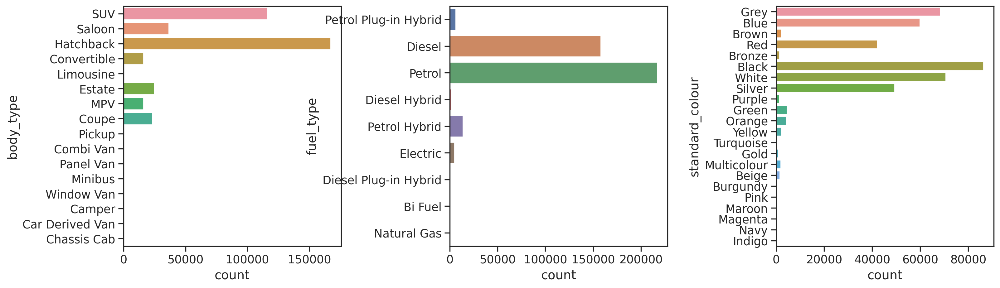

In [28]:
plt.figure(figsize=(18,5))
plt.subplots_adjust(wspace=0.5)
plt.subplot(1,3,1)
sns.countplot(y='body_type',data=advert)
plt.subplot(1,3,2)
sns.countplot(y='fuel_type',data=advert)
plt.subplot(1,3,3)
sns.countplot(y='standard_colour',data=advert)
plt.savefig("Countplot.png")

Substituting Null values in Colour with "Black", Fuel type with "Petrol", Body type with "Hatchback"

In [29]:
advert['body_type']=advert['body_type'].fillna("Hatchback")

In [30]:
advert['fuel_type']=advert['fuel_type'].fillna("Petrol")

In [31]:
advert['standard_colour']=advert['standard_colour'].fillna("Black")

In [32]:
advert.isna().sum()

mileage                  0
standard_colour          0
standard_make            0
standard_model           0
vehicle_condition        0
year_of_registration     0
price                    0
body_type                0
crossover_car_and_van    0
fuel_type                0
dtype: int64

We have already detected that our data contains outliers. We need to remove these outlier for further processing.

There are several techniques to remove outliers from the data. IQR, Z-score, standard deviation.

We will use IQR technique to remove outliers.

In [33]:
def quantile(x):
    global Q1
    global Q3
    Q1=x.quantile(0.25)
    Q3=x.quantile(0.75)
    print('Q1=',Q1,'\nQ3=',Q3)
    global IQR 
    IQR = Q3 -Q1
    print ('IQR=', IQR)
    global Lowerlimit
    Lowerlimit= Q1 - 1.5*IQR
    global Upperlimit
    Upperlimit= Q3 + 1.5*IQR
    print ("Lower limit=", Lowerlimit, "\nUpper limit=", Upperlimit)

The above quantile function is a user defined function which will find the Upper and lower quantile and also the upper and lower limit values to trim the data

We will now find the upper and lower limit of price using quantile function

In [34]:
print("IQR for price-")
quantile(advert.price)

IQR for price-
Q1= 7495.0 
Q3= 20000.0
IQR= 12505.0
Lower limit= -11262.5 
Upper limit= 38757.5


Here the lower limit is a negative value which can be ignored, i.e our lower value of price can be considered as 0 and upper limit as 38757.5
Now we will trim the data and remove all those rows with price greated than upper limit

In [35]:
advert=advert.query("price <= @Upperlimit")

We will now find the upper and lower limit of year of registration using quantile function

In [36]:
print("IQR for Year of Registration-")
quantile(advert.year_of_registration)

IQR for Year of Registration-
Q1= 2013.0 
Q3= 2018.0
IQR= 5.0
Lower limit= 2005.5 
Upper limit= 2025.5


Here the upper and lower limit are 2005 and 2025 respectively, so our data should be in between them. We will remove the data below and above our limits.

In [37]:
advert=advert.query("year_of_registration <= @Upperlimit and year_of_registration >= @Lowerlimit")

In [38]:
print("IQR for Mileage-")
quantile(advert.mileage)

IQR for Mileage-
Q1= 12126.0 
Q3= 56492.0
IQR= 44366.0
Lower limit= -54423.0 
Upper limit= 123041.0


In [39]:
advert=advert.query("mileage <= @Upperlimit")

All the outliers are now removed from the dataset, now we can use this data to make our Analysis and prediction

Let us visualise the data after removing-

<Axes: xlabel='mileage'>

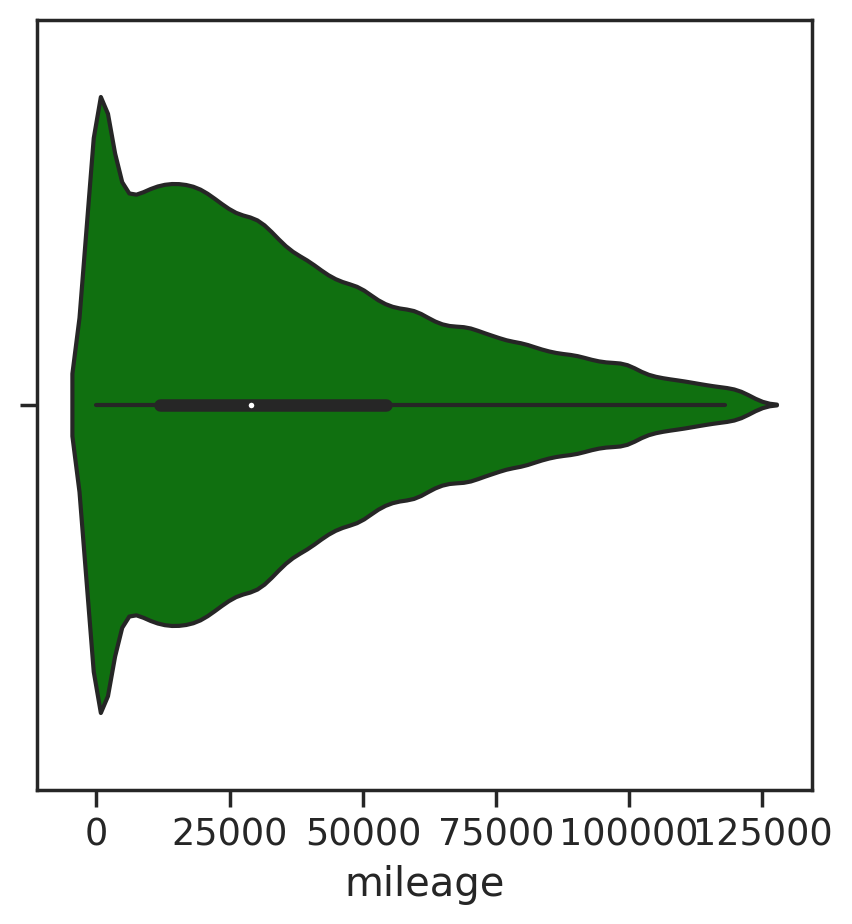

In [40]:
plt.figure(figsize=(5,5))
sns.violinplot(data=advert,x='mileage',color='green')

<Axes: xlabel='year_of_registration', ylabel='price'>

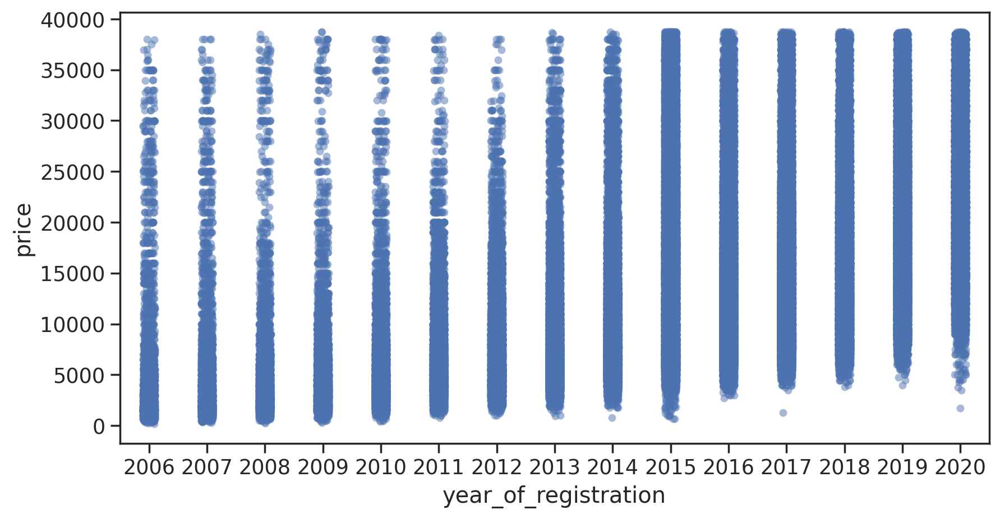

In [41]:
plt.figure(figsize=(10,5))
sns.stripplot(data=advert, x='year_of_registration',y='price',alpha=0.5)

* Removing outliers from categorical data

In [42]:
advert_copy= advert.copy()

In [43]:
advert_copy.sample()

,mileage,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type
272568,32396.0,Black,Audi,A4 Avant,USED,2017,16500,Estate,False,Diesel


In [44]:
len(advert_copy.standard_model.unique())

781

In [45]:
model_stats=advert_copy.groupby('standard_model')['standard_model'].agg('count').sort_values(ascending = True)

In [46]:
model_stats

standard_model
Will            1
Exocet          1
Fairlady        1
Fluence         1
928             1
            ...  
Polo         7363
Qashqai      7409
C Class      7673
Corsa       10368
Golf        10883
Name: standard_model, Length: 781, dtype: int64

There are 781 different types of standard models, however, there are a few models which are very less in number, for example- there is only one entry fro standard model- '110' and 5 for 'quattro'. We can detect such entries and can mark them as other standard model.

In [47]:
len(model_stats[model_stats<=5])

199

This means that there are 199 locations with less than 5 data points.

In [48]:
model_stats_less_than_5=model_stats[model_stats<=5]

In [49]:
model_stats_less_than_5

standard_model
Will          1
Exocet        1
Fairlady      1
Fluence       1
928           1
             ..
Vellfire      5
BLS           5
GranCabrio    5
807           5
FJ Cruiser    5
Name: standard_model, Length: 199, dtype: int64

In [50]:
advert_copy.standard_model=advert_copy.standard_model.apply(lambda x:'other' if x in model_stats_less_than_5 else x)
len(advert_copy.standard_model.unique())

583

We have replaced the models which had less than 5 data points with another model named 'other'

Similarly, we will perform this method on other categorical features, to reduce outliers from them.

In [51]:
len(advert_copy.standard_make.unique())

78

In [52]:
make_stats=advert_copy.groupby('standard_make')['standard_make'].agg('count').sort_values(ascending = True)

In [53]:
len(make_stats[make_stats<=5])

25

In [54]:
make_stats_less_than_5=make_stats[make_stats<=5]
make_stats_less_than_5

standard_make
Noble             1
GMC               1
Custom Vehicle    1
LEVC              1
Mev               1
Mitsuoka          1
Beauford          1
Dax               1
Replica           1
Ariel             1
Sebring           1
Plymouth          1
Pilgrim           2
Opel              2
Daimler           2
Rover             2
Aixam             2
Zenos             2
Westfield         3
Iveco             3
Hummer            3
Lincoln           3
Rolls-Royce       4
Holden            4
Morgan            5
Name: standard_make, dtype: int64

In [55]:
advert_copy.standard_make=advert_copy.standard_make.apply(lambda x:'other' if x in make_stats_less_than_5 else x)
len(advert_copy.standard_make.unique())

54

Checking for stnadrad color, Body type and Fuel type

In [56]:
len(advert_copy.standard_colour.unique())

22

In [57]:
colour_stats=advert_copy.groupby('standard_colour')['standard_colour'].agg('count').sort_values(ascending = True)

In [58]:
colour_stats

standard_colour
Indigo             1
Navy               4
Magenta           14
Burgundy          56
Maroon           129
Turquoise        286
Pink             403
Gold             621
Purple          1096
Bronze          1271
Beige           1356
Multicolour     1738
Yellow          1800
Brown           1927
Green           3399
Orange          3819
Red            39057
Silver         41900
Blue           52578
Grey           59989
White          66329
Black          79537
Name: standard_colour, dtype: int64

Here there are very few unique colours and also there are very less entries with small number of data points, hence, there are no outlier in Standard Colour

In [59]:
len(advert_copy.body_type.unique())

16

In [60]:
body_stats=advert_copy.groupby('body_type')['body_type'].agg('count').sort_values(ascending = True)
body_stats

body_type
Car Derived Van         1
Chassis Cab             1
Camper                 27
Window Van             27
Panel Van              41
Limousine              60
Minibus               119
Combi Van             173
Pickup                482
Convertible         11371
MPV                 14890
Coupe               16650
Estate              21765
Saloon              30940
SUV                 99579
Hatchback          161184
Name: body_type, dtype: int64

In [61]:
len(advert_copy.fuel_type.unique())

8

In [62]:
fuel_stats=advert_copy.groupby('fuel_type')['fuel_type'].agg('count').sort_values(ascending = True)
fuel_stats

fuel_type
Diesel Plug-in Hybrid       126
Bi Fuel                     204
Diesel Hybrid               610
Electric                   3689
Petrol Plug-in Hybrid      4029
Petrol Hybrid             12693
Diesel                   141573
Petrol                   194386
Name: fuel_type, dtype: int64

Here body_type and fuel_types also does not have Outliers

In [63]:
advert_copy.shape

(357310, 10)

In [64]:
advert_copy.sample(5)

,mileage,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type
39278,28800.0,Blue,Peugeot,108,USED,2016,5290,Hatchback,False,Petrol
111299,28559.0,Red,Peugeot,3008,USED,2018,19684,SUV,False,Diesel
338785,30903.0,Black,BMW,3 Series Gran Turismo,USED,2017,19600,Hatchback,False,Diesel
326232,21000.0,Grey,Mercedes-Benz,A Class,USED,2017,17495,Hatchback,False,Petrol
75553,47380.0,Black,Renault,Captur,USED,2017,8700,SUV,False,Diesel


The number of rows have now reduced to 357310, which were earlier 402005

In [65]:
df=advert_copy.copy()
df.tail(3)

,mileage,standard_colour,standard_make,standard_model,vehicle_condition,year_of_registration,price,body_type,crossover_car_and_van,fuel_type
402002,52760.0,White,Nissan,Qashqai,USED,2012,7250,SUV,False,Petrol
402003,10250.0,Red,Abarth,595,USED,2015,11490,Hatchback,False,Petrol
402004,14000.0,Silver,Audi,A4 Avant,USED,2014,20520,Estate,False,Diesel


In [66]:
df=df.reset_index()

Separating categorical and numerical data fro encoding

In [67]:
df_cat=df.drop(columns=['mileage','year_of_registration','price','index'])
df_cat

,standard_colour,standard_make,standard_model,vehicle_condition,body_type,crossover_car_and_van,fuel_type
0,Blue,Jaguar,XF,USED,Saloon,False,Diesel
1,Grey,SKODA,Yeti,USED,SUV,False,Petrol
2,Brown,Vauxhall,Mokka,USED,Hatchback,False,Diesel
3,Grey,Land Rover,Range Rover Sport,USED,SUV,False,Diesel
4,Blue,Audi,S5,USED,Convertible,False,Petrol
...,...,...,...,...,...,...,...
357305,Grey,Peugeot,208,USED,Hatchback,False,Petrol
357306,Red,Peugeot,107,USED,Hatchback,False,Petrol
357307,White,Nissan,Qashqai,USED,SUV,False,Petrol
357308,Red,Abarth,595,USED,Hatchback,False,Petrol


* Categorical Encoding

In [68]:
from sklearn.preprocessing import OrdinalEncoder

In [69]:
oe = OrdinalEncoder() #Ordinal Encoding

In [70]:
oe_bool = OrdinalEncoder(categories=[['USED','NEW'],[0,1]])

In [71]:
df_cat1=pd.DataFrame(oe.fit_transform(df_cat[['standard_colour','standard_make','standard_model','body_type','fuel_type']])
                    ,columns=['standard_colour','standard_make','standard_model','body_type','fuel_type'])
df_cat1

,standard_colour,standard_make,standard_model,body_type,fuel_type
0,2.0,22.0,553.0,14.0,1.0
1,8.0,42.0,560.0,13.0,5.0
2,4.0,50.0,344.0,7.0,1.0
3,8.0,25.0,415.0,13.0,1.0
4,2.0,3.0,436.0,4.0,5.0
...,...,...,...,...,...
357305,8.0,37.0,19.0,7.0,5.0
357306,17.0,37.0,2.0,7.0,5.0
357307,20.0,35.0,392.0,13.0,5.0
357308,17.0,0.0,47.0,7.0,5.0


In [72]:
df_bool=df_cat.drop(columns=['standard_colour','standard_make','standard_model','body_type','fuel_type'])
df_bool

,vehicle_condition,crossover_car_and_van
0,USED,False
1,USED,False
2,USED,False
3,USED,False
4,USED,False
...,...,...
357305,USED,False
357306,USED,False
357307,USED,False
357308,USED,False


In [73]:
df_num=df.drop(columns=['standard_colour','standard_make','standard_model','vehicle_condition','body_type','crossover_car_and_van','fuel_type','index'])
df_num

,mileage,year_of_registration,price
0,108230.0,2011,7000
1,7800.0,2017,14000
2,45000.0,2016,7995
3,64000.0,2015,26995
4,16000.0,2017,29000
...,...,...,...
357305,5179.0,2019,10595
357306,110000.0,2009,2000
357307,52760.0,2012,7250
357308,10250.0,2015,11490


In [74]:
df_bool=pd.DataFrame(oe_bool.fit_transform(df_bool),columns=['vehicle_condition','crossover_car_and_van'])
df_bool

,vehicle_condition,crossover_car_and_van
0,0.0,0.0
1,0.0,0.0
2,0.0,0.0
3,0.0,0.0
4,0.0,0.0
...,...,...
357305,0.0,0.0
357306,0.0,0.0
357307,0.0,0.0
357308,0.0,0.0


In [75]:
df_cat=df_cat1.join(df_bool)


In [76]:
df_cat=df_cat.join(df_num)

In [77]:
df_cat

,standard_colour,standard_make,standard_model,body_type,fuel_type,vehicle_condition,crossover_car_and_van,mileage,year_of_registration,price
0,2.0,22.0,553.0,14.0,1.0,0.0,0.0,108230.0,2011,7000
1,8.0,42.0,560.0,13.0,5.0,0.0,0.0,7800.0,2017,14000
2,4.0,50.0,344.0,7.0,1.0,0.0,0.0,45000.0,2016,7995
3,8.0,25.0,415.0,13.0,1.0,0.0,0.0,64000.0,2015,26995
4,2.0,3.0,436.0,4.0,5.0,0.0,0.0,16000.0,2017,29000
...,...,...,...,...,...,...,...,...,...,...
357305,8.0,37.0,19.0,7.0,5.0,0.0,0.0,5179.0,2019,10595
357306,17.0,37.0,2.0,7.0,5.0,0.0,0.0,110000.0,2009,2000
357307,20.0,35.0,392.0,13.0,5.0,0.0,0.0,52760.0,2012,7250
357308,17.0,0.0,47.0,7.0,5.0,0.0,0.0,10250.0,2015,11490


* Rescalling Data

In [78]:
Scaler=StandardScaler()

In [79]:
df_nor=pd.DataFrame(Scaler.fit_transform(df_cat)
                    ,columns=['standard_colour','standard_make','standard_model','body_type','fuel_type','vehicle_condition'
                              ,'crossover_car_and_van','mileage','year_of_registration','price'])
df_nor

,standard_colour,standard_make,standard_model,body_type,fuel_type,vehicle_condition,crossover_car_and_van,mileage,year_of_registration,price
0,-1.027410,-0.483252,1.706802,1.503360,-1.216202,-0.261965,-0.058893,2.430460,-1.403218,-0.840471
1,-0.261762,0.698867,1.746754,1.195387,0.766041,-0.261965,-0.058893,-0.943023,0.477229,0.012221
2,-0.772194,1.171714,0.513948,-0.652448,-1.216202,-0.261965,-0.058893,0.306540,0.163821,-0.719267
3,-0.261762,-0.305934,0.919176,1.195387,-1.216202,-0.261965,-0.058893,0.944757,-0.149587,1.595183
4,-1.027410,-1.606264,1.039032,-1.576366,0.766041,-0.261965,-0.058893,-0.667582,0.477229,1.839418
...,...,...,...,...,...,...,...,...,...,...
357305,-0.261762,0.403337,-1.340967,-0.652448,0.766041,-0.261965,-0.058893,-1.031063,1.104044,-0.402553
357306,0.886709,0.403337,-1.437993,-0.652448,0.766041,-0.261965,-0.058893,2.489915,-2.030033,-1.449536
357307,1.269532,0.285125,0.787905,1.195387,0.766041,-0.261965,-0.058893,0.567201,-1.089810,-0.810018
357308,0.886709,-1.783582,-1.181159,-0.652448,0.766041,-0.261965,-0.058893,-0.860726,-0.149587,-0.293530


* Spliting the data into predictor and Traget

As the goal is to predict the price of the vehicle, here target is price and rest all features are predictor

In [80]:
#target = df_cat['price']
#predictor= df_cat.drop(columns= ['price'])

In [81]:
#target.head(5)
#predictor.head(5)

* Rescaling Data 

In [82]:
X= df_nor.drop(columns= ['price']) #predictors
y= df_nor['price'] #target
X

,standard_colour,standard_make,standard_model,body_type,fuel_type,vehicle_condition,crossover_car_and_van,mileage,year_of_registration
0,-1.027410,-0.483252,1.706802,1.503360,-1.216202,-0.261965,-0.058893,2.430460,-1.403218
1,-0.261762,0.698867,1.746754,1.195387,0.766041,-0.261965,-0.058893,-0.943023,0.477229
2,-0.772194,1.171714,0.513948,-0.652448,-1.216202,-0.261965,-0.058893,0.306540,0.163821
3,-0.261762,-0.305934,0.919176,1.195387,-1.216202,-0.261965,-0.058893,0.944757,-0.149587
4,-1.027410,-1.606264,1.039032,-1.576366,0.766041,-0.261965,-0.058893,-0.667582,0.477229
...,...,...,...,...,...,...,...,...,...
357305,-0.261762,0.403337,-1.340967,-0.652448,0.766041,-0.261965,-0.058893,-1.031063,1.104044
357306,0.886709,0.403337,-1.437993,-0.652448,0.766041,-0.261965,-0.058893,2.489915,-2.030033
357307,1.269532,0.285125,0.787905,1.195387,0.766041,-0.261965,-0.058893,0.567201,-1.089810
357308,0.886709,-1.783582,-1.181159,-0.652448,0.766041,-0.261965,-0.058893,-0.860726,-0.149587


* Spliting the data into train and test 

In [83]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25)
X_train.shape, y_train.shape

((267982, 9), (267982,))

In [84]:
X_train.head()

,standard_colour,standard_make,standard_model,body_type,fuel_type,vehicle_condition,crossover_car_and_van,mileage,year_of_registration
23416,-1.027410,0.403337,-1.437993,-0.652448,0.766041,-0.261965,-0.058893,2.154011,-2.656848
104574,1.014317,-0.010404,0.063061,-0.652448,0.766041,-0.261965,-0.058893,1.314251,-2.030033
284508,-1.027410,1.289926,1.056154,1.503360,0.766041,-0.261965,-0.058893,-1.066803,1.417452
166505,-1.155018,-0.483252,1.701094,1.503360,-1.216202,-0.261965,-0.058893,1.717336,0.163821
26988,-1.027410,0.698867,0.205747,1.195387,0.766041,-0.261965,-0.058893,-1.104257,1.417452


In [85]:
y_train.head(5)

23416    -1.523233
104574   -1.297879
284508    1.656698
166505   -0.232014
26988     1.412463
Name: price, dtype: float64

## 2. Feature Engineering

* Preproseccing pipe-

Using PolynomialFeature function, we will create mutliple features with interaction function.



In [86]:
#Preprocessing Pipe

In [87]:
def to_dataframe(X):
    return pd.DataFrame(X)

In [88]:
preprocessing_pipe = Pipeline([
        ('poly', PolynomialFeatures(interaction_only=True, include_bias=False))
        #('toDF',FunctionTransformer(to_dataframe))
]).set_output(transform="pandas")

In [89]:
preprocessing_pipe

Pipeline(steps=[('poly',
                 PolynomialFeatures(include_bias=False,
                                    interaction_only=True))])

In [90]:
#Checking the number of features got created
X_pp = preprocessing_pipe.fit_transform(X)
X_pp.head()

,standard_colour,standard_make,standard_model,body_type,fuel_type,vehicle_condition,crossover_car_and_van,mileage,year_of_registration,standard_colour standard_make,...,fuel_type vehicle_condition,fuel_type crossover_car_and_van,fuel_type mileage,fuel_type year_of_registration,vehicle_condition crossover_car_and_van,vehicle_condition mileage,vehicle_condition year_of_registration,crossover_car_and_van mileage,crossover_car_and_van year_of_registration,mileage year_of_registration
0,-1.027410,-0.483252,1.706802,1.503360,-1.216202,-0.261965,-0.058893,2.430460,-1.403218,0.496497,...,0.318603,0.071626,-2.955930,1.706596,0.015428,-0.636696,0.367594,-0.143137,0.082640,-3.410465
1,-0.261762,0.698867,1.746754,1.195387,0.766041,-0.261965,-0.058893,-0.943023,0.477229,-0.182937,...,-0.200676,-0.045114,-0.722394,0.365577,0.015428,0.247039,-0.125017,0.055537,-0.028105,-0.450037
2,-0.772194,1.171714,0.513948,-0.652448,-1.216202,-0.261965,-0.058893,0.306540,0.163821,-0.904791,...,0.318603,0.071626,-0.372814,-0.199239,0.015428,-0.080303,-0.042915,-0.018053,-0.009648,0.050218
3,-0.261762,-0.305934,0.919176,1.195387,-1.216202,-0.261965,-0.058893,0.944757,-0.149587,0.080082,...,0.318603,0.071626,-1.149015,0.181928,0.015428,-0.247494,0.039187,-0.055639,0.008810,-0.141323
4,-1.027410,-1.606264,1.039032,-1.576366,0.766041,-0.261965,-0.058893,-0.667582,0.477229,1.650292,...,-0.200676,-0.045114,-0.511395,0.365577,0.015428,0.174883,-0.125017,0.039316,-0.028105,-0.318589


In [91]:
X_pp.shape

(357310, 45)

In [92]:
#Earlier there were 9 features which is not increased to 45

## 3. Feature Selection

In [93]:
#from sklearn.feature_selection import SelectKBest, f_regression
#selector = SelectKBest(f_regression, k=5).fit(X_pp, y).set_output(transform='pandas')
#X_sel = selector.transform(X_pp)

There are several feature selection methods that can be used to select the best features

* SelectKBest
* PCA(Principle Component Analysis)
* RFE(Recursive feature elimination)

#### 3.1 SelectKBest

In [94]:
#SelectKBest Method
SelectK_pipe = Pipeline(
    steps=[
        ('Polynomial', preprocessing_pipe),
        ('feat',SelectKBest(f_regression, k=10)),
        ('toDF',FunctionTransformer(to_dataframe))
    ]
)

In [95]:
SelectK_pipe

Pipeline(steps=[('Polynomial',
                 Pipeline(steps=[('poly',
                                  PolynomialFeatures(include_bias=False,
                                                     interaction_only=True))])),
                ('feat',
                 SelectKBest(score_func=<function f_regression at 0x7f100e9db0a0>)),
                ('toDF',
                 FunctionTransformer(func=<function to_dataframe at 0x7f100ab81fc0>))])

In [96]:
#checking what features got selected with SelectKBest
X_sel= SelectK_pipe.fit_transform(X_train,y_train)
X_sel.head()


,0,1,2,3,4,5,6,7,8,9
0,0.403337,-0.652448,-0.261965,2.154011,-2.656848,-0.105660,-0.200676,-0.564276,0.696002,-5.722881
1,-0.010404,-0.652448,-0.261965,1.314251,-2.030033,0.002726,-0.200676,-0.344288,0.531798,-2.667974
2,1.289926,1.503360,-0.261965,-1.066803,1.417452,-0.337916,-0.200676,0.279465,-0.371323,-1.512142
3,-0.483252,1.503360,-0.261965,1.717336,0.163821,0.126595,0.318603,-0.449882,-0.042915,0.281336
4,0.698867,1.195387,-0.261965,-1.104257,1.417452,-0.183079,-0.200676,0.289277,-0.371323,-1.565231


In [97]:
#As we supplied  k=5, the SelectKbest selected the best 5 features in relation with the target(price)
#Selected features are -body_type,vehicle_condition,mileage,year_of_registration,vehicle_condition ,year_of_registration

#### 3.2 PCA(Principle Component Analysis)

In [98]:
#PCA Method of dimentionality reduction

In [99]:
PCA_pipe= Pipeline(
    steps=[
        ('Polynomial', preprocessing_pipe),
        ('PCA', PCA(0.75)),
         ('toDF',FunctionTransformer(to_dataframe))
    ]
)

In [100]:
PCA_pipe

Pipeline(steps=[('Polynomial',
                 Pipeline(steps=[('poly',
                                  PolynomialFeatures(include_bias=False,
                                                     interaction_only=True))])),
                ('PCA', PCA(n_components=0.75)),
                ('toDF',
                 FunctionTransformer(func=<function to_dataframe at 0x7f100ab81fc0>))])

In [101]:
X_sel=PCA_pipe.fit_transform(X_train,y_train)
X_sel.shape

(267982, 21)

In [102]:
#The PCA reduced the number of features to 21 when asked to retain 75% of the data

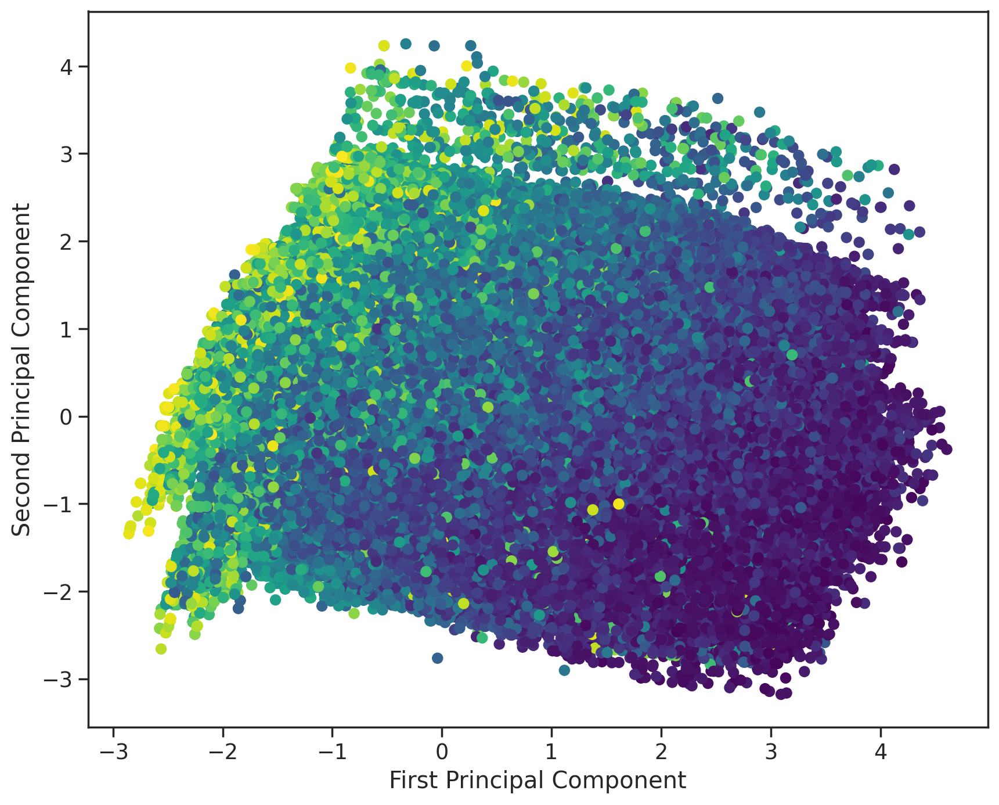

In [103]:
pca = PCA(n_components=5)
X_pca = pca.fit_transform(X)
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y, cmap='viridis')
plt.xlabel('First Principal Component')
plt.ylabel('Second Principal Component')
plt.show()

#### 3.3 RFE(Recursive feature elimination)

We will be using three models for aur prediction test, therefore for every model we will create a RFE pipe

In [104]:
#RFE with linear model

RFE_linear_pipe=Pipeline(
    steps=[
        ('Polynomial', preprocessing_pipe),
        ('RFE', RFE(LinearRegression(), n_features_to_select=10)),
        
    ]
)

## 4. Model Building

We will be using the following three models for our predicton-
* Linear Model
* Random Forest
* Boosted Tree

#### 4.1 Linear model

###### 4.1.1Linear model with SelectKbest feature selection method

In [105]:
#Linear model with SelectKbest feature selection method

lmSK_pipe=Pipeline(
    steps=[
        ('feature',SelectK_pipe),
        ('linear', LinearRegression())
    ]
    
)

In [106]:
lmSK_pipe.fit(X_train,y_train)

Pipeline(steps=[('feature',
                 Pipeline(steps=[('Polynomial',
                                  Pipeline(steps=[('poly',
                                                   PolynomialFeatures(include_bias=False,
                                                                      interaction_only=True))])),
                                 ('feat',
                                  SelectKBest(score_func=<function f_regression at 0x7f100e9db0a0>)),
                                 ('toDF',
                                  FunctionTransformer(func=<function to_dataframe at 0x7f100ab81fc0>))])),
                ('linear', LinearRegression())])

In [107]:
# Linear model with selectkbest train score
lmSK_trainscore=lmSK_pipe.score(X_train,y_train)
lmSK_trainscore

0.4906253551208094

In [108]:
# Linear model with selectkbest test score
lmSK_testscore=lmSK_pipe.score(X_test,y_test)
lmSK_testscore

0.49293160869873665

In [109]:
# Linear model with selectkbest test score
lmSK_rmse=rmse(y_test, lmSK_pipe.predict(X_test))
lmSK_rmse

0.7122400205622809

In [110]:
linSK_scores = cross_val_score(lmSK_pipe, X_train, y_train, cv=10, scoring='neg_root_mean_squared_error')
linSK_scores.mean()*-1, linSK_scores.std()

(0.7103277341147957, 0.006814440044989199)

In [111]:
lin_predict = lmSK_pipe.predict(X_test)
lin_predict

array([-0.8150914 , -0.37424887,  0.59643004, ..., -1.06884168,
        0.61317673, -0.70477708])

###### 4.1.2 Linear Model with PCA feature selection method

In [112]:
#Linear Model with PCA feature selection method
lmPCA_pipe=Pipeline(
    steps=[
        ('feature',PCA_pipe),
        ('linear', LinearRegression())
    ]
    
)

In [113]:
lmPCA_pipe.fit(X_train,y_train)

Pipeline(steps=[('feature',
                 Pipeline(steps=[('Polynomial',
                                  Pipeline(steps=[('poly',
                                                   PolynomialFeatures(include_bias=False,
                                                                      interaction_only=True))])),
                                 ('PCA', PCA(n_components=0.75)),
                                 ('toDF',
                                  FunctionTransformer(func=<function to_dataframe at 0x7f100ab81fc0>))])),
                ('linear', LinearRegression())])

In [114]:
# Linear model with PCA train score
lmPCA_trainscore=lmPCA_pipe.score(X_train,y_train)
lmPCA_trainscore

0.411978008261507

In [115]:
# Linear model with PCA test score
lmPCA_testscore=lmPCA_pipe.score(X_test,y_test)
lmPCA_testscore

0.41057572373555784

In [116]:
# Linear model with PCA test score
lmPCA_rmse=rmse(y_test, lmPCA_pipe.predict(X_test))
lmPCA_rmse

0.7679043235083949

In [117]:
linPCA_scores = cross_val_score(lmPCA_pipe, X_train, y_train, cv=10, scoring='neg_root_mean_squared_error')
linPCA_scores.mean()*-1, linPCA_scores.std()

(0.7652984408519916, 0.0040222475979054375)

######4.1.3 Linear Model with RFE feature selection method

In [118]:
##Linear Model with RFE feature selection method
RFE_linear_pipe.fit(X_train,y_train)

Pipeline(steps=[('Polynomial',
                 Pipeline(steps=[('poly',
                                  PolynomialFeatures(include_bias=False,
                                                     interaction_only=True))])),
                ('RFE',
                 RFE(estimator=LinearRegression(), n_features_to_select=10))])

In [119]:
# Linear model with RFE train score
lmRFE_trainscore=RFE_linear_pipe.score(X_train,y_train)
lmRFE_trainscore

0.5156158006160831

In [120]:
# Linear model with RFE test score
lmRFE_testscore=RFE_linear_pipe.score(X_test,y_test)
lmRFE_testscore

0.5153475551004313

In [121]:
# Linear model with RFE test score
lmRFE_rmse=rmse(y_test, RFE_linear_pipe.predict(X_test))
lmRFE_rmse

0.6963190988625588

#### 4.2 RandomForest Model

In [122]:
#RandomForest model with SelectKbest feature selection method
rfSK_pipe=Pipeline(
    steps=[
        ('feature',SelectK_pipe),
        ('RF', RandomForestRegressor(max_depth=10))
    ]
    
)

In [123]:
##RandomForest Model with selectkbest feature selection method
rfSK_pipe.fit(X_train,y_train)

Pipeline(steps=[('feature',
                 Pipeline(steps=[('Polynomial',
                                  Pipeline(steps=[('poly',
                                                   PolynomialFeatures(include_bias=False,
                                                                      interaction_only=True))])),
                                 ('feat',
                                  SelectKBest(score_func=<function f_regression at 0x7f100e9db0a0>)),
                                 ('toDF',
                                  FunctionTransformer(func=<function to_dataframe at 0x7f100ab81fc0>))])),
                ('RF', RandomForestRegressor(max_depth=10))])

In [124]:
# RandomForest model with selectkbest train score
rfSK_trainscore=rfSK_pipe.score(X_train,y_train)
rfSK_trainscore

0.8035610477571897

In [125]:
# RandomForest model with selectkbest test score
rfSK_testscore=rfSK_pipe.score(X_test,y_test)
rfSK_testscore

0.7977945748093185

In [126]:
# RandomForest model with selectkbest test score
rfSK_rmse=rmse(y_test, rfSK_pipe.predict(X_test))
rfSK_rmse

0.449768985938332

In [127]:
rf_predict = rfSK_pipe.predict(X_test)
rf_predict

array([-0.9666537 ,  0.66585041,  0.43054602, ..., -1.34016757,
       -0.05252246, -0.17010357])

* Grid Search to evaluate best parameter

In [128]:
#Considering only 10% of train data to perform grid serach and further evaluation pf models

In [129]:
X_train_small, _, y_train_small, _ = train_test_split(X_train, y_train, test_size=0.90, random_state=42)

In [130]:
X_train_small.shape

(26798, 9)

In [131]:
y_train_small.shape

(26798,)

In [132]:
grid_param = {
    'n_estimators': [50,100],
    'max_depth': [2,8, 5, 10, 20, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}


In [133]:
grid = GridSearchCV(
    RandomForestRegressor(), 
    grid_param,
    scoring='neg_mean_absolute_error',
    return_train_score=True
)

In [ ]:
grid.fit(X_train_small,y_train_small)

In [ ]:
grid.best_params_

{'max_depth': 20,
 'min_samples_leaf': 1,
 'min_samples_split': 5,
 'n_estimators': 100}

In [ ]:
grid.best_score_

-0.2239701025590123

In [ ]:
grid.cv_results_

{'mean_fit_time': array([0.4164185 , 0.82807031, 0.40595174, 0.76875873, 0.39669642,
        0.7902339 , 0.4289062 , 0.79420257, 0.40418038, 0.78846893,
        0.3909831 , 0.81804361, 0.38737621, 0.77161059, 0.3889493 ,
        0.7772121 , 0.41552448, 0.78617144, 1.19997478, 2.4448638 ,
        1.18590612, 2.51884799, 1.30274701, 2.46349158, 1.16792388,
        2.43644023, 1.18355637, 2.43127651, 1.21385179, 2.39326224,
        1.25735474, 2.41254773, 1.21602168, 2.41277504, 1.20169168,
        2.42519197, 0.8133688 , 1.67239242, 0.83346839, 1.66967559,
        0.80577903, 1.63160481, 0.85481272, 1.66459465, 0.89478593,
        1.64697137, 0.83750591, 1.69016299, 0.81412778, 1.69940872,
        0.84119511, 1.68755827, 0.81169062, 1.66796823, 1.45195513,
        2.92579522, 1.4942234 , 2.90809059, 1.4247005 , 2.93351717,
        1.46492496, 2.94505701, 1.44087095, 2.89492249, 1.45345631,
        2.87269387, 1.44491448, 2.91258769, 1.46032286, 2.90454807,
        1.47923541, 2.89956231,

In [ ]:
gsrf_results = pd.DataFrame(grid.cv_results_).sort_values('rank_test_score')

In [ ]:
gsrf_results[['param_max_depth', 'mean_train_score', 'mean_test_score', 'rank_test_score']]

,param_max_depth,mean_train_score,mean_test_score,rank_test_score
75,20,-0.119536,-0.223970,1
73,20,-0.094205,-0.223975,2
93,None,-0.115505,-0.224637,3
91,None,-0.086179,-0.224708,4
74,20,-0.120554,-0.224866,5
...,...,...,...,...
1,2,-0.608672,-0.609582,104
2,2,-0.608645,-0.609650,105
9,2,-0.608729,-0.609687,106
10,2,-0.608789,-0.609819,107


In [ ]:
#Random forest regressor predictions with best parameters 
#'max_depth': 20,
# 'min_samples_leaf': 1,
# 'min_samples_split': 2,
# 'n_estimators': 100

In [135]:
rfr= RandomForestRegressor(n_estimators=100, max_depth=20, min_samples_leaf=1, min_samples_split=2)

In [136]:
RFR=Pipeline(
    steps=[
        ('feature',SelectK_pipe),
        ('RF', rfr)
    ]
    
)

In [137]:
RFR.fit(X_train,y_train)

Pipeline(steps=[('feature',
                 Pipeline(steps=[('Polynomial',
                                  Pipeline(steps=[('poly',
                                                   PolynomialFeatures(include_bias=False,
                                                                      interaction_only=True))])),
                                 ('feat',
                                  SelectKBest(score_func=<function f_regression at 0x7f100e9db0a0>)),
                                 ('toDF',
                                  FunctionTransformer(func=<function to_dataframe at 0x7f100ab81fc0>))])),
                ('RF', RandomForestRegressor(max_depth=20))])

In [138]:
RFR_predict=RFR.predict(X_test)

In [139]:
RFR_trainscore=RFR.score(X_train,y_train)
RFR_trainscore

0.9211554948619669

In [140]:
RFR_testscore=RFR.score(X_test,y_test)
RFR_testscore

0.8390679100066012

In [141]:
RFR_rmse=rmse(y_test, rfSK_pipe.predict(X_test))
RFR_rmse

0.449768985938332

#### 4.3 Gradient Boosted Tree Model

In [142]:
#Gradient Boosted Tree model with SelectKbest feature selection method

gbrSK_pipe=Pipeline(
    steps=[
        ('feature',SelectK_pipe),
        ('GBR', GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42))
    ]
    
)

In [143]:
gbrSK_pipe.fit(X_train,y_train)

Pipeline(steps=[('feature',
                 Pipeline(steps=[('Polynomial',
                                  Pipeline(steps=[('poly',
                                                   PolynomialFeatures(include_bias=False,
                                                                      interaction_only=True))])),
                                 ('feat',
                                  SelectKBest(score_func=<function f_regression at 0x7f100e9db0a0>)),
                                 ('toDF',
                                  FunctionTransformer(func=<function to_dataframe at 0x7f100ab81fc0>))])),
                ('GBR', GradientBoostingRegressor(random_state=42))])

In [144]:
# GBR model with selectkbest train score
gbrSK_trainscore=gbrSK_pipe.score(X_train,y_train)
gbrSK_trainscore

0.769324547268126

In [145]:
# GBR model with selectkbest test score
gbrSK_testscore=gbrSK_pipe.score(X_test,y_test)
gbrSK_testscore

0.7692811940922917

In [146]:
# GBR model with selectkbest test score
gbrSK_rmse=rmse(y_test, gbrSK_pipe.predict(X_test))
gbrSK_rmse

0.4804349585048169

In [147]:
gbr_predict= gbrSK_pipe.predict(X_test)
gbr_predict

array([-1.08146118e+00,  3.35919261e-01,  9.22319846e-01, ...,
       -1.51067281e+00, -6.51571054e-04, -4.73079883e-04])

In [ ]:
param_grid = {
    'learning_rate': [0.01, 0.1, 1],
    'n_estimators': [20, 50, 100],
    'max_depth': [3, 5, 7],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

In [ ]:
grid_search =GridSearchCV(
    GradientBoostingRegressor(), 
    grid_param,
    scoring='neg_mean_absolute_error',
    return_train_score=True
)

In [ ]:
grid_search.fit(X_train_small, y_train_small)

GridSearchCV(estimator=GradientBoostingRegressor(),
             param_grid={'max_depth': [2, 8, 5, 10, 20, None],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [50, 100]},
             return_train_score=True, scoring='neg_mean_absolute_error')

In [ ]:
grid_search.best_params_

{'max_depth': 10,
 'min_samples_leaf': 1,
 'min_samples_split': 10,
 'n_estimators': 100}

In [ ]:
grid.best_score_

-0.2239701025590123

In [ ]:
gsbt_results = pd.DataFrame(grid.cv_results_).sort_values('rank_test_score')

In [ ]:
gsrf_results[['param_max_depth', 'mean_train_score', 'mean_test_score', 'rank_test_score']]

,param_max_depth,mean_train_score,mean_test_score,rank_test_score
75,20,-0.119536,-0.223970,1
73,20,-0.094205,-0.223975,2
93,None,-0.115505,-0.224637,3
91,None,-0.086179,-0.224708,4
74,20,-0.120554,-0.224866,5
...,...,...,...,...
1,2,-0.608672,-0.609582,104
2,2,-0.608645,-0.609650,105
9,2,-0.608729,-0.609687,106
10,2,-0.608789,-0.609819,107


In [ ]:
#Gradient Boosted Tree with best parameters 
#'max_depth': 8,
# 'min_samples_leaf': 2,
# 'min_samples_split': 10,
# 'n_estimators': 100

In [148]:
GBR = Pipeline(
    steps=[
        ('feature',SelectK_pipe),
        ('GBR', GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=8,min_samples_leaf=2,min_samples_split=10, random_state=42))
    ]
    
)

In [149]:
GBR.fit(X_train,y_train)

Pipeline(steps=[('feature',
                 Pipeline(steps=[('Polynomial',
                                  Pipeline(steps=[('poly',
                                                   PolynomialFeatures(include_bias=False,
                                                                      interaction_only=True))])),
                                 ('feat',
                                  SelectKBest(score_func=<function f_regression at 0x7f100e9db0a0>)),
                                 ('toDF',
                                  FunctionTransformer(func=<function to_dataframe at 0x7f100ab81fc0>))])),
                ('GBR',
                 GradientBoostingRegressor(max_depth=8, min_samples_leaf=2,
                                           min_samples_split=10,
                                           random_state=42))])

In [150]:
GBR_predict=GBR.predict(X_test)

In [151]:
GBR_trainscore=GBR.score(X_train,y_train)
GBR_trainscore

0.8578594472286742

In [152]:
GBR_testscore=GBR.score(X_test,y_test)
GBR_testscore

0.850616580828665

In [153]:
GBR_rmse=rmse(y_test, GBR_predict)
GBR_rmse

0.38658437894886344

#### 4.4 Voter Ensemble


In [ ]:
#voter Ensemble to determine the best model out of the three used

In [ ]:
ensembled = [ lmSK_pipe, rfSK_pipe, gbrSK_pipe ]

In [ ]:
for est in ensembled:
    est.fit(X_train, y_train)

In [ ]:
ensemble = VotingRegressor(
    [
        ("lm", lmSK_pipe), 
        ("rf", rfSK_pipe), 
        ("gb", gbrSK_pipe)
    ]
)
ensemble.fit(X_train, y_train)

VotingRegressor(estimators=[('lm',
                             Pipeline(steps=[('feature',
                                              Pipeline(steps=[('Polynomial',
                                                               Pipeline(steps=[('poly',
                                                                                PolynomialFeatures(include_bias=False,
                                                                                                   interaction_only=True)),
                                                                               ('toDF',
                                                                                FunctionTransformer(func=<function to_dataframe at 0x000002DA958964C0>))])),
                                                              ('feat',
                                                               SelectKBest(score_func=<function f_regression at 0x000002DAA451E700>)),
                                                 

In [ ]:
all_regr = ensembled + [ ensemble ]

In [ ]:
for est in all_regr:
    scores = cross_val_score(est, X_train, y_train, cv=5, scoring='neg_root_mean_squared_error')
    print(scores.mean()*-1, scores.std())

0.7137944954855686 0.0025702204403095967
0.4517138686544963 0.0025519477248256415
0.4853960136480436 0.003342222069978418
0.5030386130148161 0.0025198758024962014


In [ ]:
xt = X.head(20)
pred1 = lmSK_pipe.predict(xt)
pred2 = rfSK_pipe.predict(xt)
pred3 = gbrSK_pipe.predict(xt)
pred4 = ensemble.predict(xt)

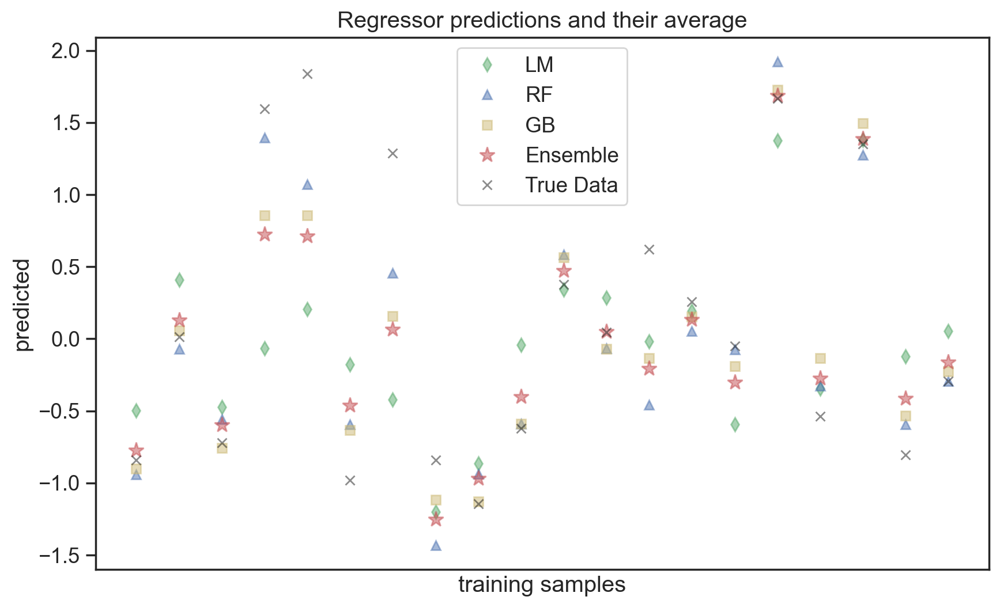

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(pred1, "gd", alpha=0.5, label="LM")
plt.plot(pred2, "b^", alpha=0.5, label="RF")
plt.plot(pred3, "ys", alpha=0.5, label="GB")
plt.plot(pred4, "r*", alpha=0.5, ms=10, label="Ensemble")
plt.plot(y.head(20), "kx", alpha=0.5, label="True Data")

plt.tick_params(axis="x", which="both", bottom=False, top=False, labelbottom=False)
plt.ylabel("predicted")
plt.xlabel("training samples")
plt.legend(loc="best")
plt.title("Regressor predictions and their average")

plt.show()

In [ ]:
instance = X.head(1)
(lmSK_pipe.predict(instance), rfSK_pipe.predict(instance), gbrSK_pipe.predict(instance), ensemble.predict(instance))

(array([-0.49821922]),
 array([-0.93925032]),
 array([-0.90179534]),
 array([-0.77449637]))

### 5. Model Evaluation 

##### 5.1 Overall Performance with Cross-Validation

In [154]:
#Ranking Models based on their scores
results = {'Regression_Model': ['LM', 'RFM', 'GBT'],
        'RMSE': [lmSK_rmse, RFR_rmse, GBR_rmse],
        'Train_Accuracy_score':[lmSK_trainscore,RFR_trainscore,GBR_trainscore],
        'Test_Accuracy_score':[lmSK_testscore,RFR_testscore,GBR_testscore]}

In [155]:
model_score= pd.DataFrame(results)
model_score

,Regression_Model,RMSE,Train_Accuracy_score,Test_Accuracy_score
0,LM,0.712240,0.490625,0.492932
1,RFM,0.449769,0.921155,0.839068
2,GBT,0.386584,0.857859,0.850617


<Axes: xlabel='Regression_Model', ylabel='RMSE'>

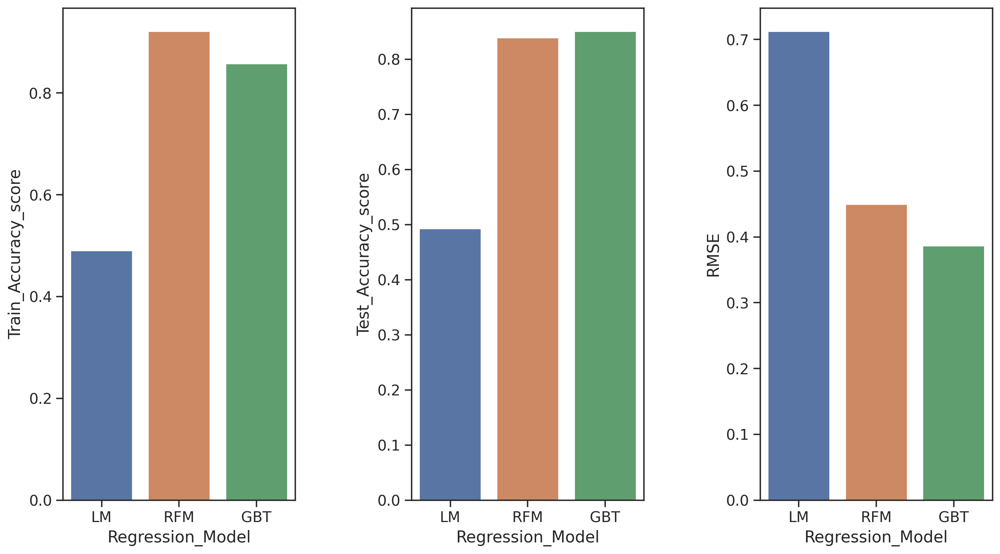

In [156]:
plt.figure(figsize=(15,8))
plt.subplots_adjust(wspace=0.5)
plt.subplot(1,3,1)
sns.barplot(data=model_score,x='Regression_Model',y='Train_Accuracy_score')
plt.subplot(1,3,2)
sns.barplot(data=model_score,x='Regression_Model',y='Test_Accuracy_score')
plt.subplot(1,3,3)
sns.barplot(data=model_score,x='Regression_Model',y='RMSE')

In [157]:
from sklearn.model_selection import cross_val_score

In [158]:
#linear model cross validation
lin_scores = cross_val_score(lmSK_pipe, X_train_small, y_train_small, cv=10, scoring='neg_root_mean_squared_error')
lin_scores.mean()*-1, lin_scores.std()

(0.7091625276454189, 0.01410993024216711)

In [159]:
#Random Forest model cross validation
RFR_scores = cross_val_score(RFR, X_train_small, y_train_small, cv=10, scoring='neg_root_mean_squared_error')
RFR_scores.mean()*-1, RFR_scores.std()

(0.44815482751287405, 0.010889974075121342)

In [160]:
#Gradient Boosted Tree model cross validation
GBR_scores = cross_val_score(GBR, X_train_small, y_train_small, cv=10, scoring='neg_root_mean_squared_error')
GBR_scores.mean()*-1, GBR_scores.std()

(0.40796880734810503, 0.009698763124455003)

##### 5.2 True Vs Predict Analysis for the Models

* Cross Grained Evaluation for Linear Model

In [161]:
from sklearn.metrics import r2_score

In [162]:
r2_lin = r2_score(y_test, lin_predict)
r2_lin

0.49293160869873665

In [163]:
mae_lin = mean_absolute_error(y_test, lin_predict)
mae_lin

0.5361407499742423

In [164]:
mse_lin=mean_squared_error( y_test,lin_predict)
mse_lin

0.5072858468905583

* Actual vs predicted value plot for Linear model

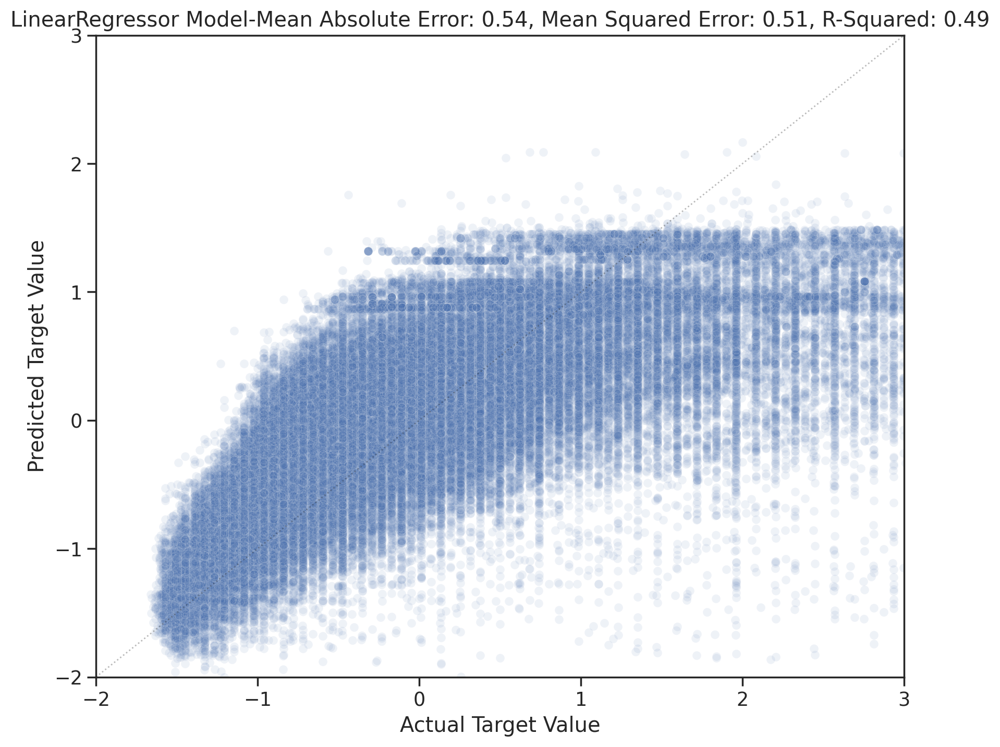

In [165]:
ax = sns.scatterplot(x=y_test, y=lin_predict, alpha=0.09)
ax.set_xlabel('Actual Target Value')
ax.set_ylabel('Predicted Target Value')
plt.title("LinearRegressor Model-Mean Absolute Error: {:.2f}, Mean Squared Error: {:.2f}, R-Squared: {:.2f}".format(mae_lin, mse_lin, r2_lin))
ax.set_xlim(-2,3)
ax.set_ylim(-2,3)
ax.plot((-2,3), (-2,3), ':k', alpha=0.3, lw=1);
plt.savefig("Predicted Vs Actual for Linear Regressor.png")

* Cross Grained Evaluation for Random Forest Regressor model

In [166]:
r2_rf = r2_score(y_test, RFR_predict)
r2_rf

0.8390679100066012

In [167]:
mae_rf = mean_absolute_error(y_test, RFR_predict)
mae_rf

0.26587984037662354

In [168]:
mse_rf=mean_squared_error( y_test,RFR_predict)
mse_rf

0.1610011055011022

* Actual Vs Predicted Value Plot for Random Forest Regressor 

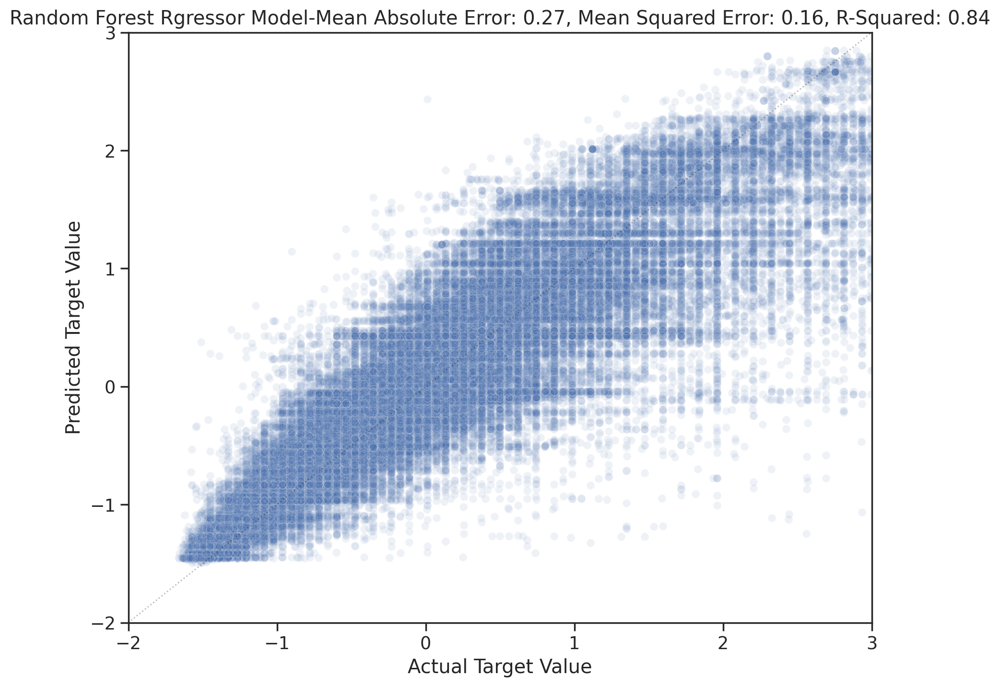

In [169]:
ax = sns.scatterplot(x=y_test, y=rf_predict, alpha=0.09)
ax.set_xlabel('Actual Target Value')
ax.set_ylabel('Predicted Target Value')
plt.title("Random Forest Rgressor Model-Mean Absolute Error: {:.2f}, Mean Squared Error: {:.2f}, R-Squared: {:.2f}".format(mae_rf, mse_rf, r2_rf))
ax.set_xlim(-2,3)
ax.set_ylim(-2,3)
ax.plot((-2,3), (-2,3), ':k', alpha=0.3, lw=1);
plt.savefig("Predicted Vs Actual for Random Forest Regressor.png")

In [170]:
r2_gbr = r2_score(y_test, GBR_predict)
r2_gbr

0.850616580828665

In [171]:
mae_gbr = mean_absolute_error(y_test, GBR_predict)
mae_gbr

0.264092792675215

In [172]:
mse_gbr = mean_squared_error( y_test,GBR_predict)
mse_gbr

0.14944748204727845

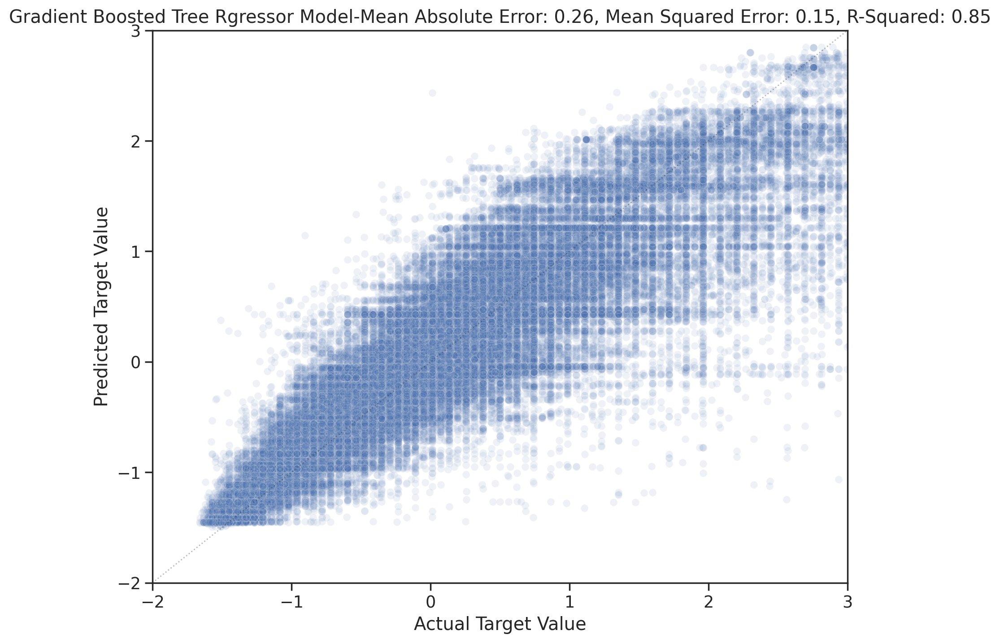

In [173]:
ax = sns.scatterplot(x=y_test, y=rf_predict, alpha=0.09)
ax.set_xlabel('Actual Target Value')
ax.set_ylabel('Predicted Target Value')
plt.title("Gradient Boosted Tree Rgressor Model-Mean Absolute Error: {:.2f}, Mean Squared Error: {:.2f}, R-Squared: {:.2f}".format(mae_gbr, mse_gbr, r2_gbr))
ax.set_xlim(-2,3)
ax.set_ylim(-2,3)
ax.plot((-2,3), (-2,3), ':k', alpha=0.3, lw=1);
plt.savefig("Predicted Vs Actual for Boosted Tree Regressor.png")

##### 5.3  Global and Local Explanations with SHAP

In [ ]:
#importing Shap libraries
!pip install -q shap
import shap
shap.initjs()

In [ ]:
explainer = shap.Explainer(RFR.predict, X_train_small)


In [ ]:
shap_values = explainer(X_train_small)

Exact explainer: 26799it [3:12:57,  2.31it/s]                             


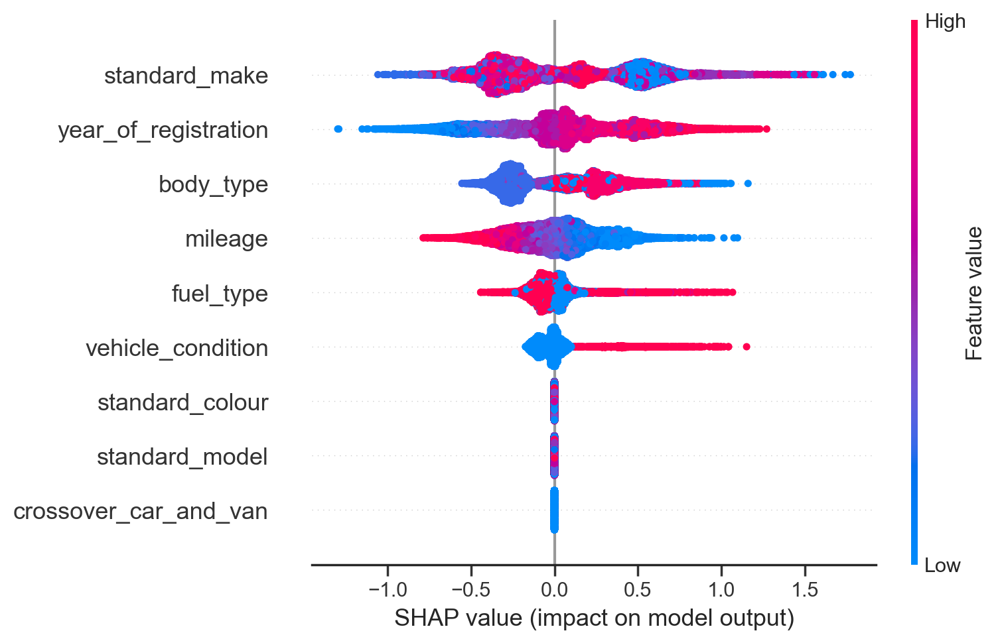

In [ ]:
shap.summary_plot(
    shap_values, 
    X_train_small
)

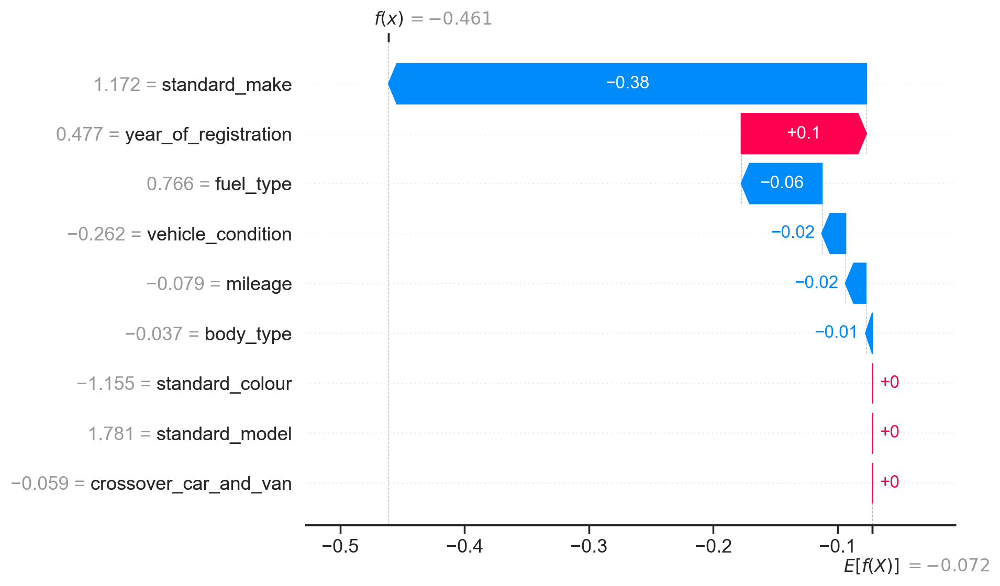

In [ ]:
shap.plots.waterfall(shap_values[0])

In [ ]:
explainer_gbr = shap.Explainer(GBR.predict, X_train_small)

In [ ]:
shap_values_gbr = explainer_gbr(X_train_small)

Exact explainer: 26799it [41:33, 10.71it/s]                            


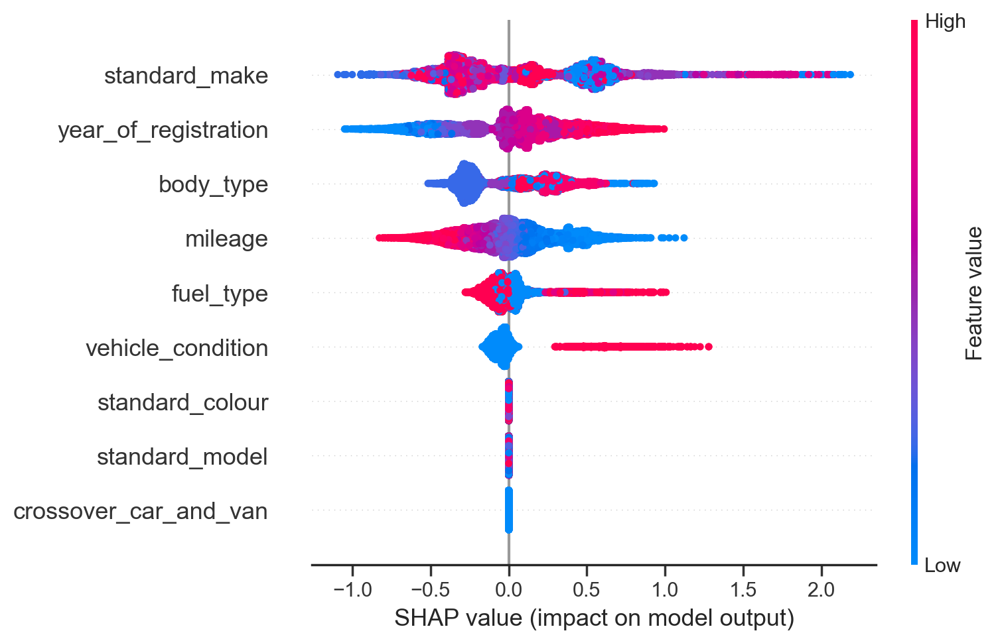

In [ ]:
shap.summary_plot(
    shap_values_gbr, 
    X_train_small
)

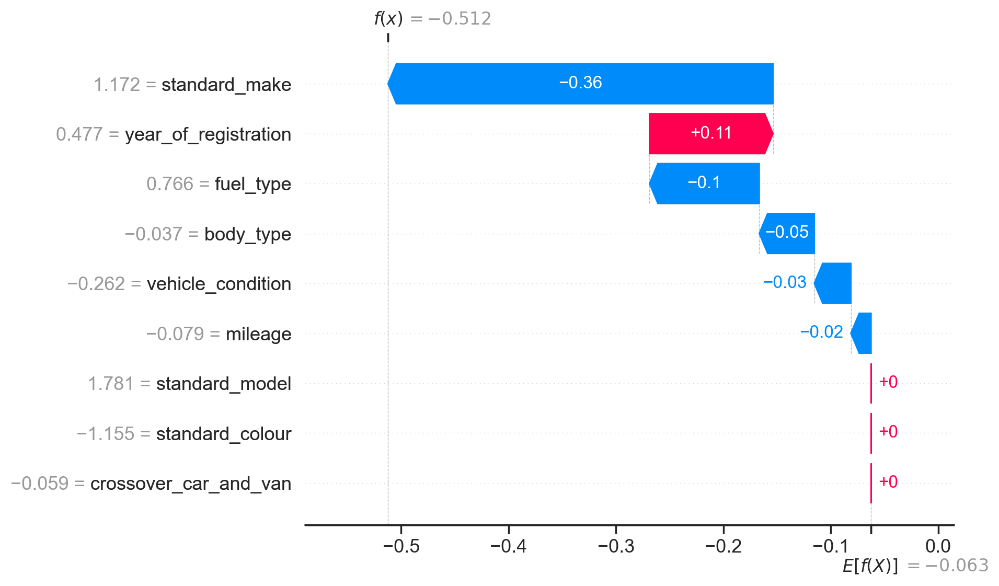

In [ ]:
shap.plots.waterfall(shap_values_gbr[0])

###### 5.4 Partial Dependency Plot

In [ ]:
from sklearn.inspection import PartialDependenceDisplay

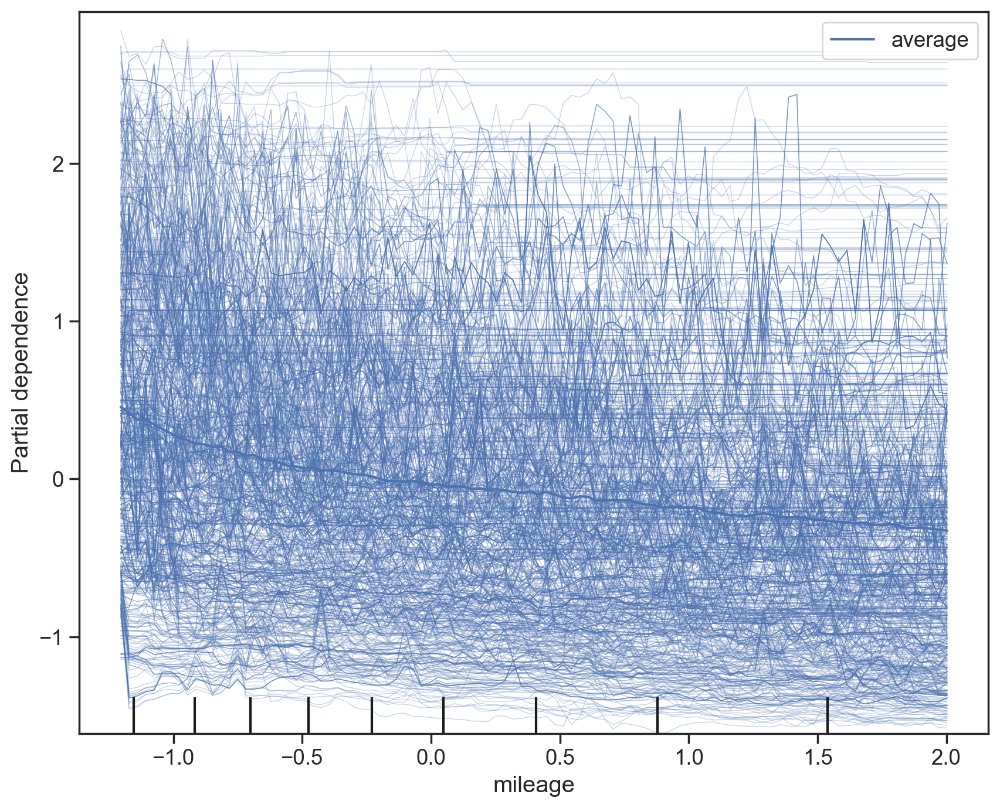

In [ ]:
PartialDependenceDisplay.from_estimator(
    RFR, X_test, features=['mileage'], kind='both'
);

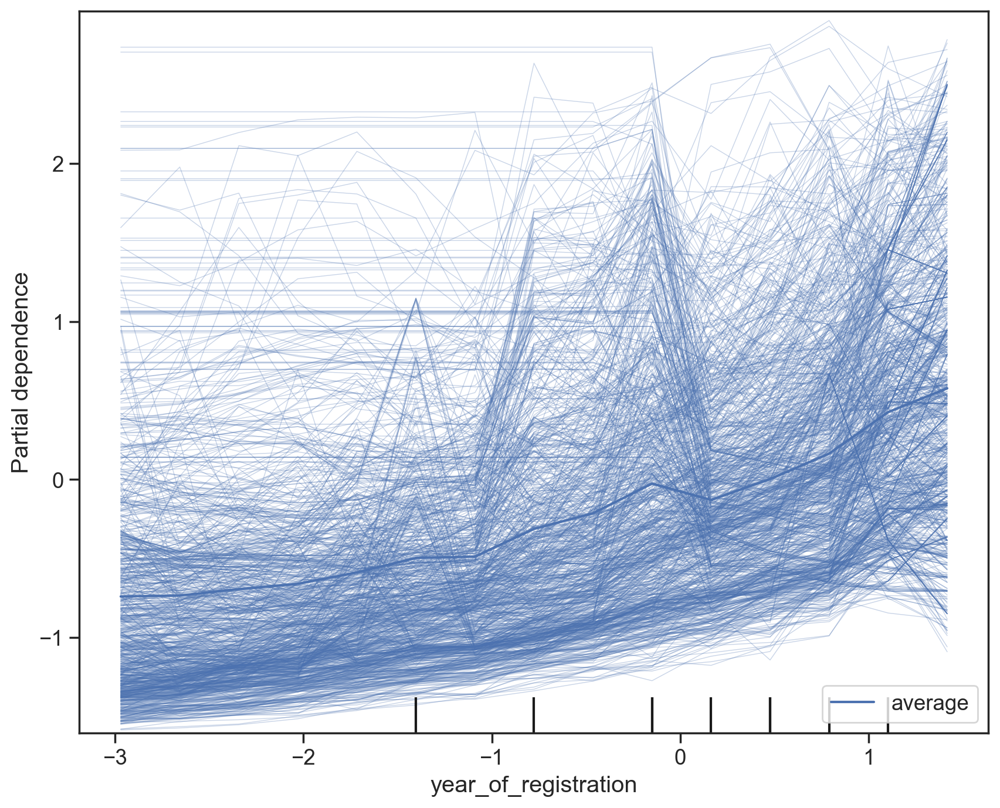

In [ ]:
PartialDependenceDisplay.from_estimator(
    RFR, X_test, features=['year_of_registration'], kind='both'
);

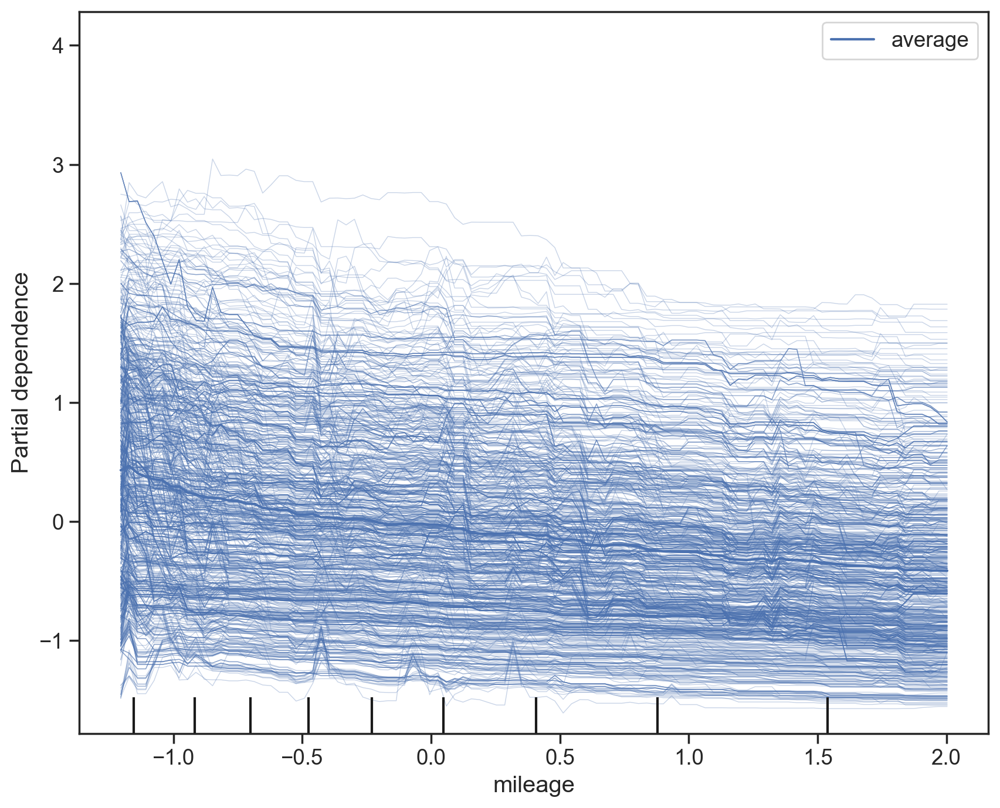

In [ ]:
PartialDependenceDisplay.from_estimator(
    GBR, X_test, features=['mileage'], kind='both'
);

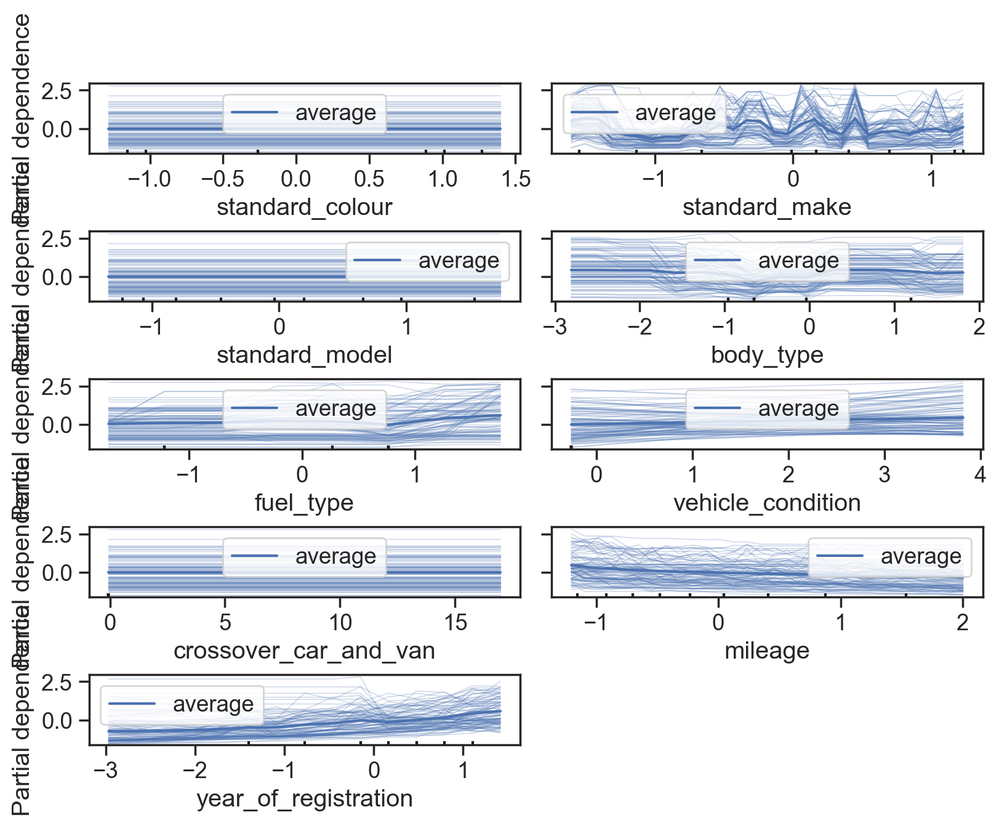

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)
PartialDependenceDisplay.from_estimator(
    RFR, X_test, features=X_test.select_dtypes(exclude='object').columns,
    kind='both',
    subsample=100, grid_resolution=30, n_jobs=2, random_state=0,
    ax=ax, n_cols=2
);

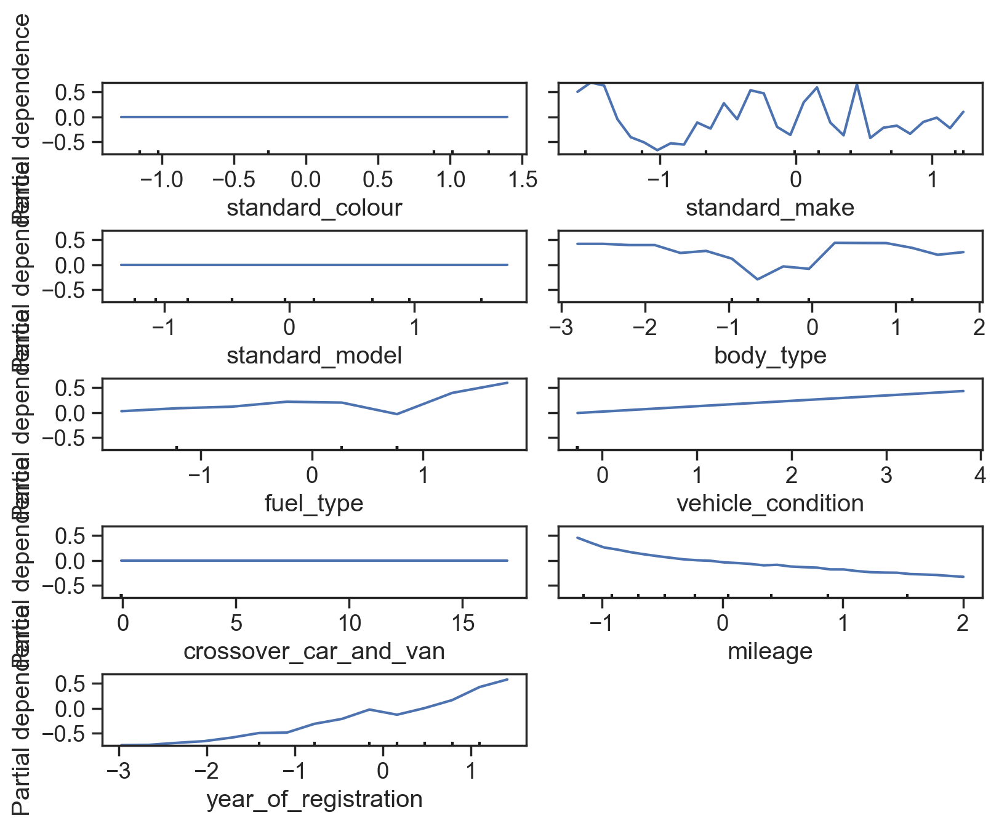

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)
PartialDependenceDisplay.from_estimator(
    RFR, X_test, features=X_test.select_dtypes(exclude='object').columns,
    kind='average', 
    subsample=100, grid_resolution=30, n_jobs=2, random_state=0,
    ax=ax, n_cols=2
);

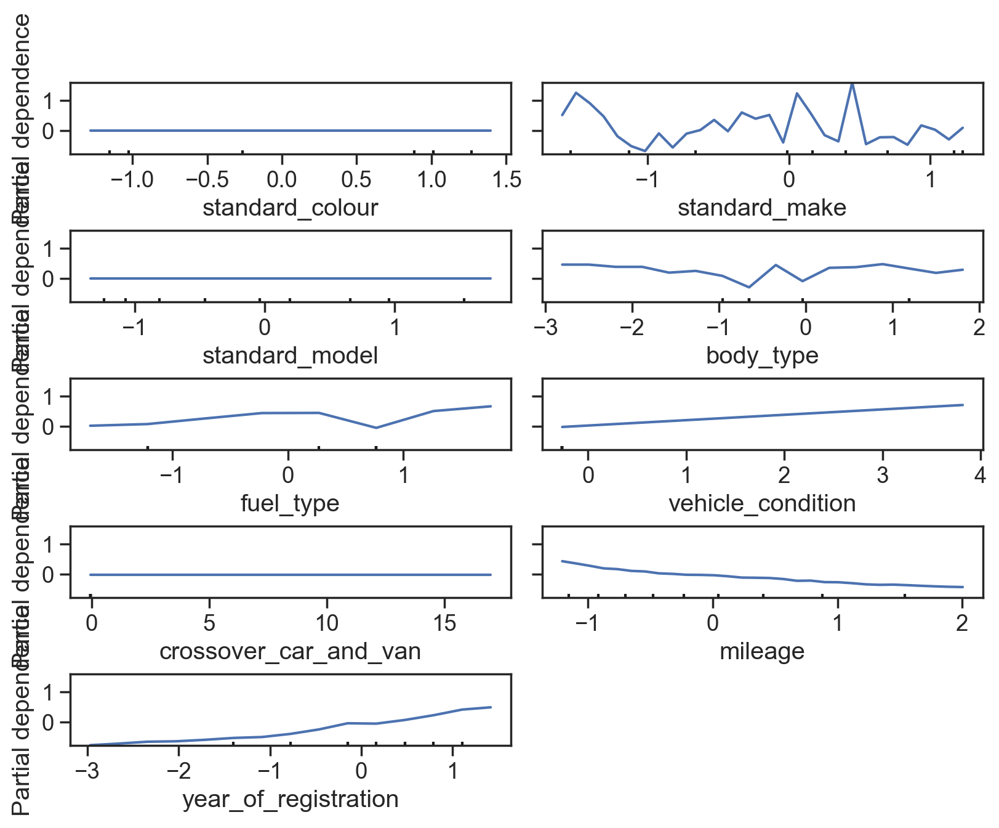

In [ ]:
fig, ax = plt.subplots(figsize=(8,6), constrained_layout=True)
PartialDependenceDisplay.from_estimator(
    GBR, X_test, features=X_test.select_dtypes(exclude='object').columns,
    kind='average', 
    subsample=100, grid_resolution=30, n_jobs=2, random_state=0,
    ax=ax, n_cols=2
);